# Задача
Ще разгледаме следната задача от Kaggle - https://www.kaggle.com/c/airbus-ship-detection, но като задача за object detection, а не за сегментация, тъй като е по-прост, но и същевременно достатъчно интересен проблем. 

# Решение

След кратко проучване открих, че един от най-добрите модели за тази задача би бил RetinaNet: https://arxiv.org/abs/1708.02002

![title](images/retinanet.png)

Модела е базиран на една фаза - т.е. няма предварително предсказване на подходящи ограждащи прозорци. Използва се sliding window с pyramid feature-и, което го прави подходящ за откриване на обекти с различни размери. Иновацията при този модел е Focal Loss функцията, която в голяма степен разрешава проблема с това, че голяма част от картинките е background (class imbalance).

Използваме следната имплементация: https://github.com/fizyr/keras-retinanet, базирана на Keras.

Направих "transfer learning" с цел по-бързо трениране, като използвах за backbone resent50 мрежа, тренирана с keras-retinanet върху MS COCO дейтасета. Модела може да се свали от тук: https://github.com/fizyr/keras-retinanet/releases

## Използвани материали

https://www.kaggle.com/kmader/baseline-u-net-model-part-1

https://www.kaggle.com/voglinio/from-masks-to-bounding-boxes

# Конвертиране на задачата до такава за object detection

За да променим задачата, ще трябва да преобразуваме тестовите и треноровъчните данни. Ще преобразуваме RLE маските в boundinb box-ове.

In [1]:
import os
import cv2
from tqdm import tqdm
import numpy as np 
import pandas as pd
from skimage.measure import regionprops

import matplotlib.pyplot as plt

from config import ship_dir, train_image_dir, bboxes_file

from skimage.morphology import label

# ref: https://www.kaggle.com/paulorzp/run-length-encode-and-decode
def rle_decode(mask_rle, shape=(768, 768)):
    '''
    mask_rle: run-length as string formated (start length)
    shape: (height,width) of array to return 
    Returns numpy array, 1 - mask, 0 - background
    '''
    s = mask_rle.split()
    starts, lengths = [np.asarray(x, dtype=int) for x in (s[0:][::2], s[1:][::2])]
    starts -= 1
    ends = starts + lengths
    img = np.zeros(shape[0]*shape[1], dtype=np.uint8)
    for lo, hi in zip(starts, ends):
        img[lo:hi] = 1
    return img.reshape(shape).T  # Needed to align to RLE direction

def masks_as_image(in_mask_list, all_masks=None):
    # Take the individual ship masks and create a single mask array for all ships
    if all_masks is None:
        all_masks = np.zeros((768, 768), dtype = np.int16)
    #if isinstance(in_mask_list, list):
    for mask in in_mask_list:
        if isinstance(mask, str):
            all_masks += rle_decode(mask)
    return np.expand_dims(all_masks, -1)


In [2]:
image_masks_df = pd.read_csv('../data/train_ship_segmentations_v2.csv')
unique_images = image_masks_df['ImageId'].unique()

Запазваме данните, за да можем да ги използваме за трениране на keras-retinanet

In [3]:
i = 0

bboxes_list = []
for image in tqdm(unique_images):
    rle_0 = image_masks_df.query('ImageId=="'+image+'"')['EncodedPixels']
    mask_0 = masks_as_image(rle_0)

    lbl_0 = label(mask_0) 
    region_props = regionprops(lbl_0)

    i=0
    if region_props:
        for prop in region_props:
            bboxes_list.append([image, prop.bbox[1], prop.bbox[0], prop.bbox[4], prop.bbox[3], 'ship'])
            i+=1            
    else:
        bboxes_list.append([image, '', '', '', '', ''])

    i = i + 1
    if i % 500 == 0:
        gc.collect()

bboxes_df = pd.DataFrame(data=bboxes_list, columns=['image_id', 'x1', 'y1', 'x2', 'y2', 'class']).set_index('image_id')
bboxes_df.to_csv(bboxes_file, header=False)

Получихме данните за bounding box-овете в CSV файл, който можем да заредим наготово

In [4]:
images_df = pd.read_csv(bboxes_file, header=None, names=['image_id', 'x1', 'y1', 'x2', 'y2', 'class'], index_col='image_id')

# Convert float columns to int, so they can be used to draw the bounding boxes without casting
for col in ['x1', 'y1', 'x2', 'y2']:
    images_df[col] = images_df[col].fillna(-1)
    images_df[col] = images_df[col].astype('Int32')
    images_df[col] = images_df[col].replace(-1, np.nan)

In [5]:
print(images_df.shape)
images_df.head()

(223591, 5)


,x1,y1,x2,y2,class
image_id,,,,,
00003e153.jpg,NaN,NaN,NaN,NaN,NaN
0001124c7.jpg,NaN,NaN,NaN,NaN,NaN
000155de5.jpg,344,465,448,501,ship
000194a2d.jpg,67,377,85,387,ship
000194a2d.jpg,258,174,306,185,ship


## Проверка

Сега да визуализираме картинките с bounding box-ове, за да проверим дали правилно сме трансформирали данните

Image 000155de5.jpg


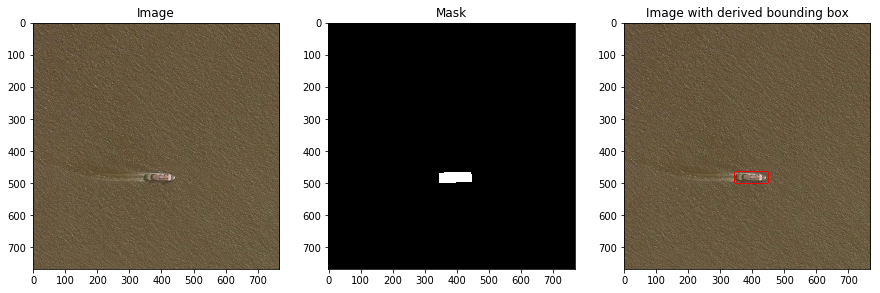

Image 000194a2d.jpg


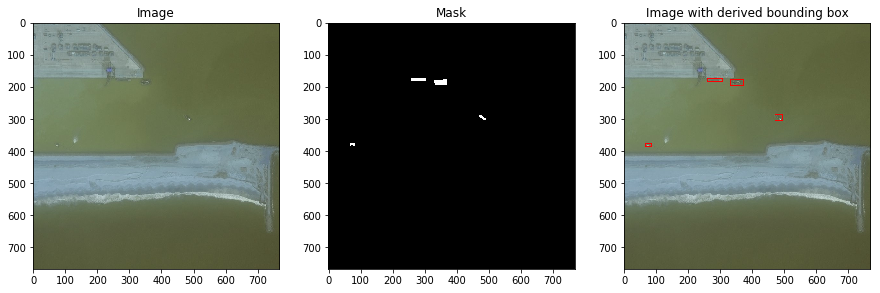

Image 00021ddc3.jpg


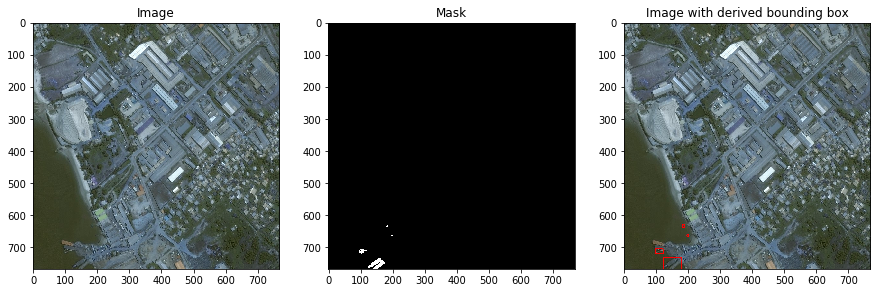

Image 0002756f7.jpg


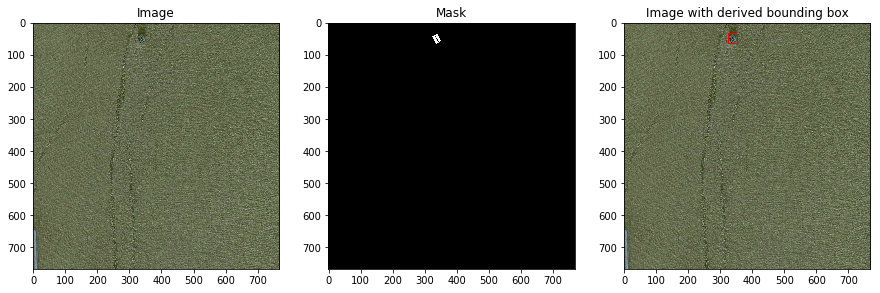

Image 00031f145.jpg


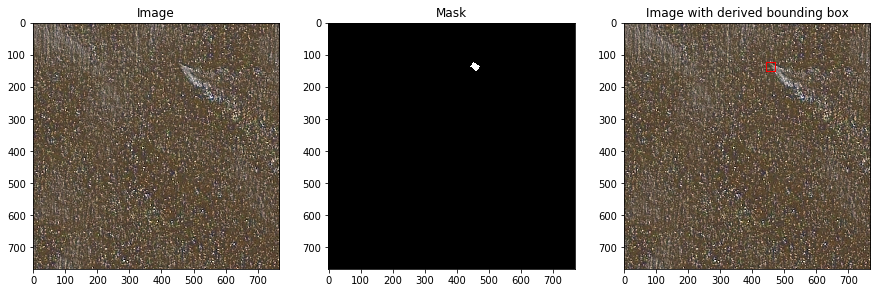

Image 000532683.jpg


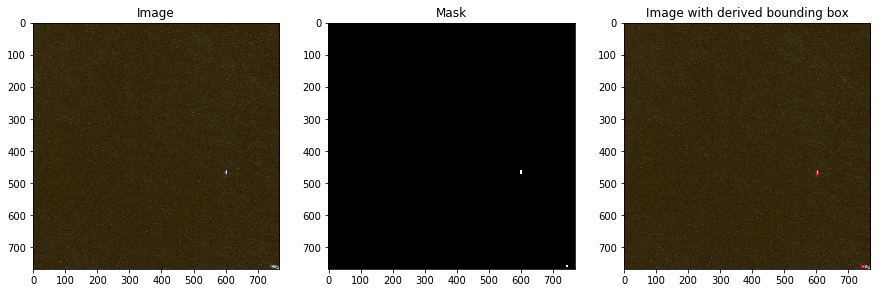

Image 00053c6ba.jpg


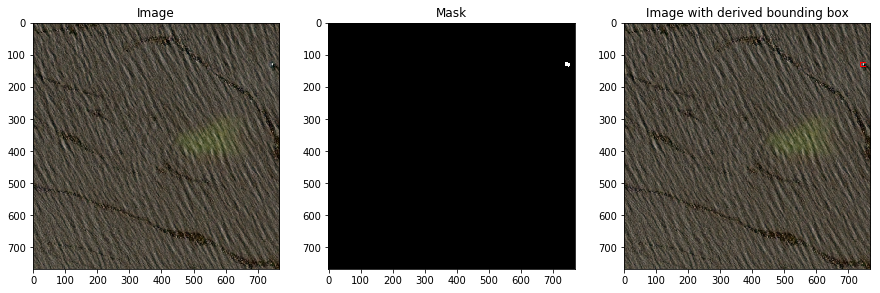

Image 0005d01c8.jpg


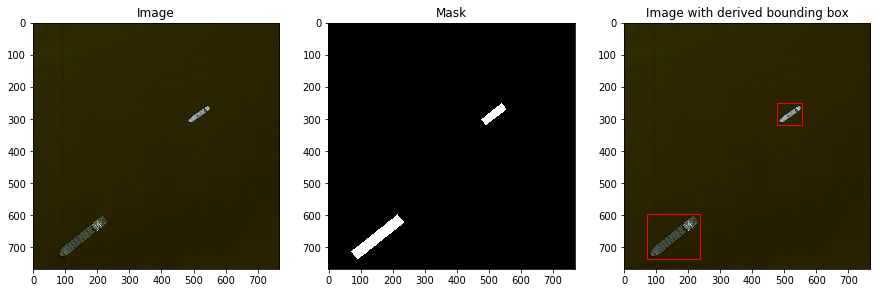

Image 0005d6d95.jpg


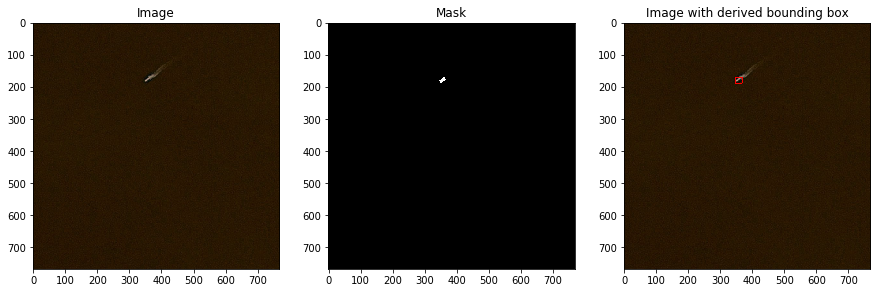

Image 0006c52e8.jpg


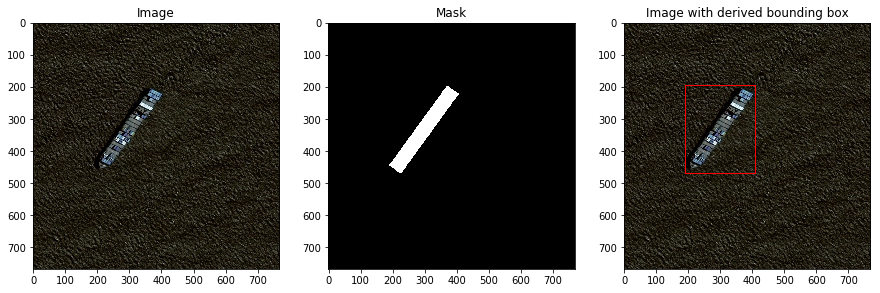

In [11]:
unique_images = images_df.loc[images_df['class'] == 'ship'].index.unique()

for i in range(10):
    image_name = unique_images[i]

    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize = (15, 5))
    img_0 = cv2.imread(train_image_dir+'/' + image_name)
    rle = image_masks_df.query('ImageId=="' + image_name + '"')['EncodedPixels']
    mask = masks_as_image(rle)

    bounding_boxes = images_df.query('image_id=="'+image_name+'"')

    img_1 = img_0.copy()
    print ('Image', image_name)
    for index, bounding_box in bounding_boxes.iterrows():
        cv2.rectangle(img_1, \
                      (bounding_box['x1'], bounding_box['y1']), \
                      (bounding_box['x2'], bounding_box['y2']), \
                      (255, 0, 0), 2)

    ax1.imshow(img_0)
    ax1.set_title('Image')
    ax2.set_title('Mask')
    ax3.set_title('Image with derived bounding box')
    ax2.imshow(mask[...,0], cmap='gray')
    ax3.imshow(img_1)
    plt.show()

Всичко изглежда наред.

# Филтриране на данните

In [1]:
import os
import numpy as np 
import pandas as pd

import seaborn as sns
sns.set(style="darkgrid")

from config import bboxes_file, train_image_dir

import matplotlib.pyplot as plt
# Needed to fix the issue that pd.DataFrame.hist() doesn't show anything the first time it's executed
plt.close('all')

from sklearn.model_selection import train_test_split

import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

## Зареждане на данните

In [2]:
images_df = pd.read_csv(bboxes_file, header=None, names=['image_id', 'x1', 'y1', 'x2', 'y2', 'class'], index_col='image_id')

# Convert float columns to int, so they can be used to draw the bounding boxes without casting
for col in ['x1', 'y1', 'x2', 'y2']:
    images_df[col] = images_df[col].fillna(-1)
    images_df[col] = images_df[col].astype('Int32')
    images_df[col] = images_df[col].replace(-1, np.nan)

## Разглеждане на данните

In [3]:
print("Dataset shape: ", images_df.shape)
images_df.head()

Dataset shape:  (223591, 5)


,x1,y1,x2,y2,class
image_id,,,,,
00003e153.jpg,NaN,NaN,NaN,NaN,NaN
0001124c7.jpg,NaN,NaN,NaN,NaN,NaN
000155de5.jpg,344,465,448,501,ship
000194a2d.jpg,67,377,85,387,ship
000194a2d.jpg,258,174,306,185,ship


In [4]:
images_df.loc[images_df['class'] == 'ship', 'ships'] = 1

unique_images_df = images_df.groupby(images_df.index).agg({'ships': 'sum'}).reset_index()
unique_images_df['has_ship'] = unique_images_df['ships'].map(lambda x: 1.0 if x>0 else 0.0)

# We don't need the 'ships' column in the main dataframe anymore
images_df = images_df.drop(['ships'], axis=1)

Да разгледаме разпределението по брой кораби

In [5]:
unique_images_df[unique_images_df['ships'] >= 0]['ships'].value_counts()

0.0     150000
1.0      28775
2.0       7290
3.0       2787
4.0       1404
5.0        754
6.0        473
7.0        348
8.0        228
9.0        161
10.0       118
11.0        76
12.0        62
13.0        36
15.0        23
14.0        15
28.0         2
31.0         2
17.0         1
24.0         1
Name: ships, dtype: int64

Да видим визуално разпределението на картинките, като премахнем тези без кораби, тъй като те само ще 

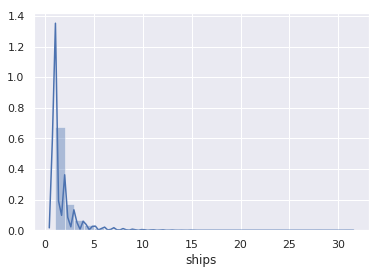

In [6]:
sns.distplot(unique_images_df[unique_images_df['ships'] > 0]['ships'], bins=30);

Нека разгледаме големините на файловете

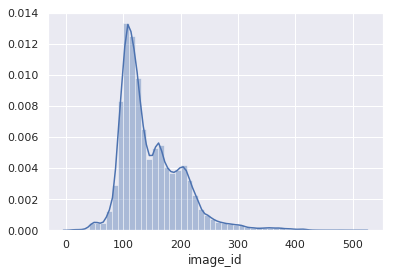

In [7]:
sns.distplot(unique_images_df['image_id'].map(
    lambda c_img_id: 
        os.stat(os.path.join(train_image_dir, c_img_id)).st_size/1024
));

В baseline kernel-а в Кагъл се филтрират картинките, които са по-малки от 50кб, но разгледах някои от тях и изглеждаха валидни картинки. Размерът им е по-малък, защото в тях преобладава един цвят (син). Затова реших да ги оставя.

## Изводи

1) Имаме огромен дейтасет и за да можем да направим няколко експериментa, ще трябва да го намалим

2) Иглежда на 3/4 от картинките няма нито един кораб. Ако оставим данните със същата пропорция по-скоро ще забавим тренирането на модела, отколкото ще повишим точността. 

## Намаляване не dataset-а

In [8]:
unique_images_df.shape

(192556, 3)

In [9]:
unique_images_df['grouped_ship_count'] = unique_images_df['ships'].map(lambda x: (x+1)//2).clip(0, 7)
def sample_ships(in_df, base_rep_val=5000):
    if in_df['ships'].values[0]==0:
        return in_df.sample(base_rep_val//3, random_state=42) # even more strongly undersample no ships
    else:
        return in_df.sample(min(base_rep_val, in_df.shape[0]), random_state=42)
    
balanced_unique_images_df = unique_images_df.groupby('grouped_ship_count') \
    .apply(sample_ships) \
    .set_index('image_id') \
    .drop(['grouped_ship_count'], axis=1)

unique_images_df = unique_images_df.drop(['grouped_ship_count'], axis=1)


Да разгледаме получените данни, за да видим дали са добре балансирани

In [10]:
print('Shape: ', balanced_unique_images_df.shape)
balanced_unique_images_df.describe()

Shape:  (13157, 2)


,ships,has_ship
count,13157.000000,13157.000000
mean,2.752603,0.873375
std,2.539438,0.332565
min,0.000000,0.000000
25%,1.000000,1.000000
50%,2.000000,1.000000
75%,4.000000,1.000000
max,31.000000,1.000000


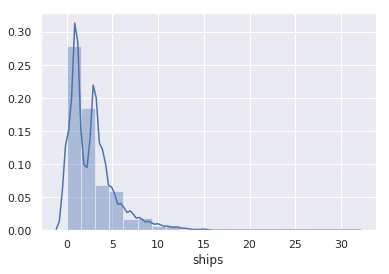

In [11]:
sns.distplot(balanced_unique_images_df['ships'], bins=20);

In [12]:
balanced_unique_images_df['ships'].value_counts()

1.0     4020
3.0     2787
0.0     1666
4.0     1404
2.0      980
5.0      754
6.0      473
7.0      348
8.0      228
9.0      161
10.0     118
11.0      76
12.0      62
13.0      36
15.0      23
14.0      15
28.0       2
31.0       2
24.0       1
17.0       1
Name: ships, dtype: int64

Ако пуснем train_test_split със stratify='ships' ще получим грешка, тъй като има класове, за които имаме само по един пример (ships=17, ships=24, ...). Затова ще обединим в един клас (ships=14) всички картинки, които имат >= 14 кораба

In [13]:
balanced_unique_images_df['ships'] = balanced_unique_images_df['ships'].clip(0, 14)

In [14]:
def train_test_split_df(in_df, test_size):
    train_ids, test_ids = train_test_split(
        in_df, 
        test_size = test_size, 
        stratify = in_df['ships'],
        random_state=42)


    train_df = pd.merge(images_df, train_ids, left_index=True, right_index=True).drop(['ships', 'has_ship'], axis=1)
    test_df = pd.merge(images_df, test_ids, left_index=True, right_index=True).drop(['ships', 'has_ship'], axis=1)

    return train_df, test_df, train_ids
    
train_validation_df, test_df, train_validation_ids = train_test_split_df(balanced_unique_images_df, test_size=0.2)
train_df, validation_df, _ = train_test_split_df(train_validation_ids, test_size=0.25)

print(train_df.shape[0], 'training examples')
print(validation_df.shape[0], 'validation examples')
print(test_df.shape[0], 'test examples')

22715 training examples
7587 validation examples
7580 test examples


Имаме доста повече примери отколкото картинки, защото много от картинките имат по повече от един анотиран кораб

Ще запазим генерираните train, validation и test данни, за да можем да ги подадем на keras_retinanet модела

In [15]:
def save_bboxes_to_file(bboxes_df, filename):
    bboxes_df.to_csv(filename, header=False)

In [16]:
save_bboxes_to_file(train_df, os.path.join(train_image_dir, 'train.csv'))
save_bboxes_to_file(validation_df, os.path.join(train_image_dir, 'validation.csv'))
save_bboxes_to_file(test_df, os.path.join(train_image_dir, 'test.csv'))

# Подбиране на настройки за модела

keras-retinanet ни предоставя инструменти, с които можем да проверим дали тренировъчните данни са анотирани правилно. Също така, можем да видим кои са опорните bounding box-ове (в жълт цвят). Корабите, които са оградени в червено са с размер, който възпрепятства засичането им, с използваните настройки на алгоритъма за опорни bounding box-ове. Данните за тези кораби просто ще се изхвърлят от алгоритъма. Корабите, около които има зелени и жълти box-ове ще се засекат от модела. Зелените box-ове показват bounding box-овете от анотациите.

Нека първо разгледаме картинките с настройките на модела по подразбиране

Using TensorFlow backend.


Image ../data/train_v2/89c428510.jpg


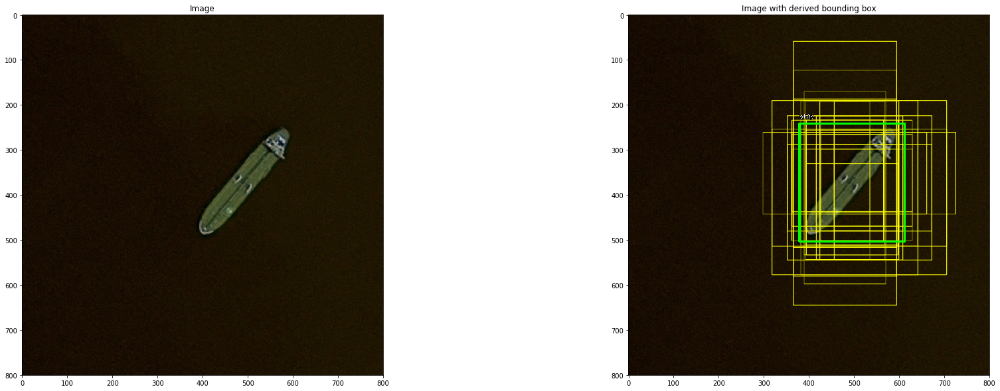

Image ../data/train_v2/aec367d77.jpg


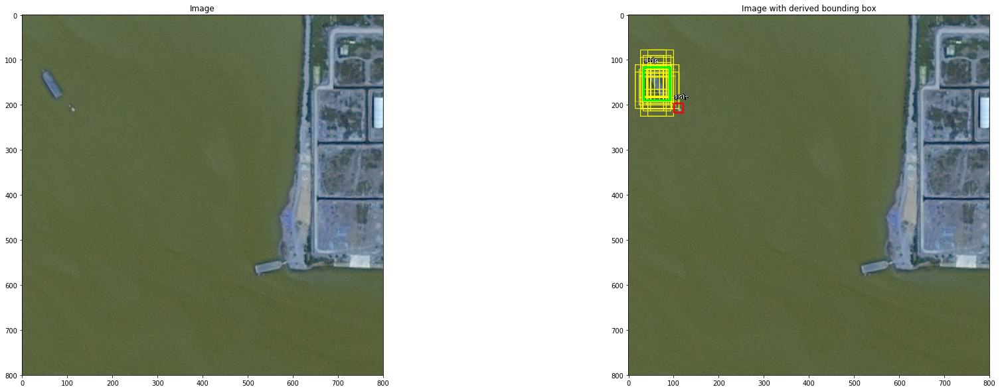

Image ../data/train_v2/9c9d84825.jpg


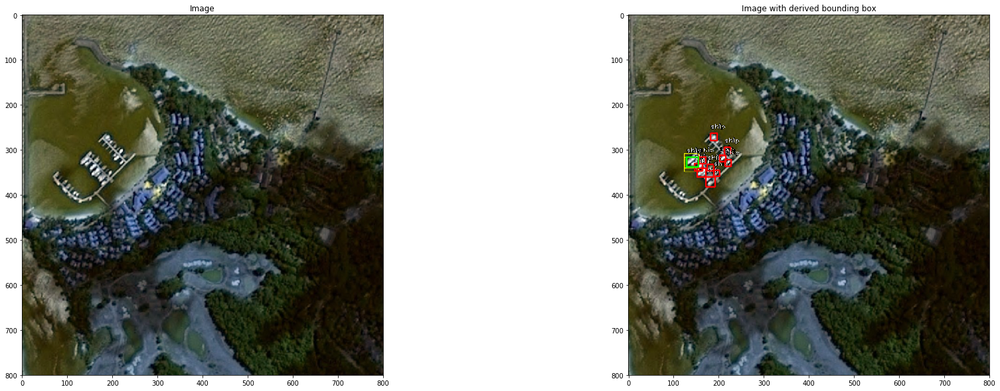

Image ../data/train_v2/07f5077e4.jpg


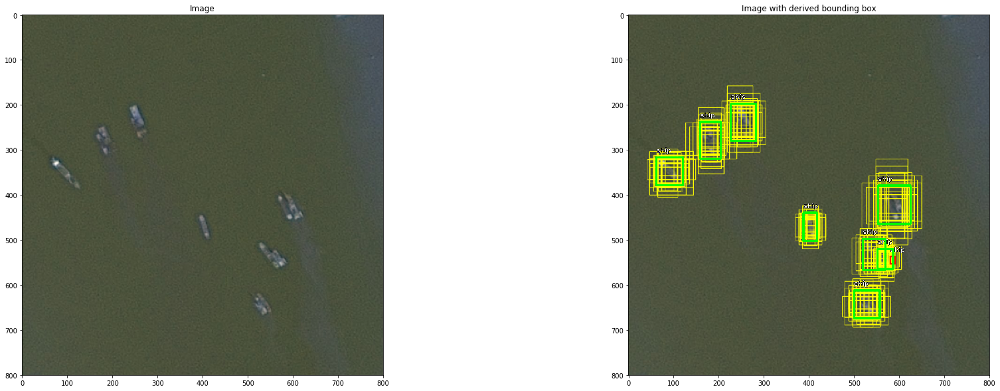

Image ../data/train_v2/4a46b4c0c.jpg


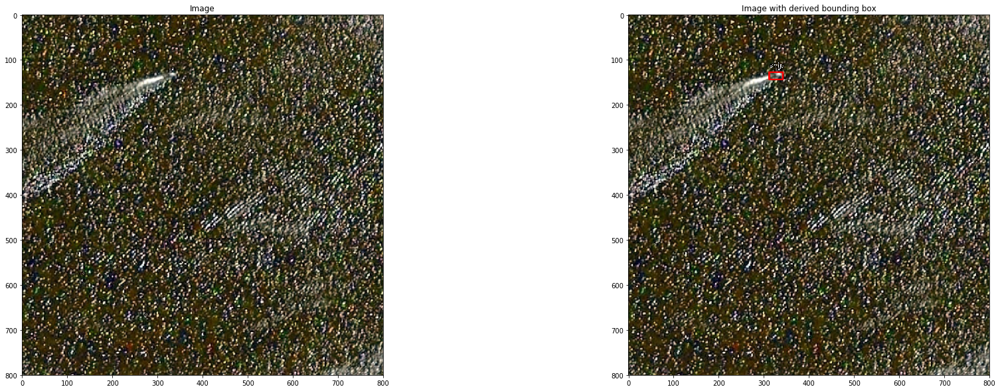

Image ../data/train_v2/559eeffea.jpg


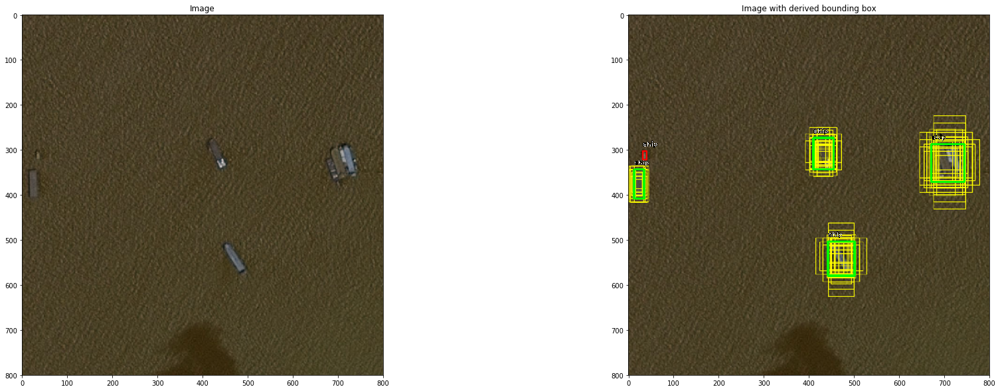

Image ../data/train_v2/c88114242.jpg


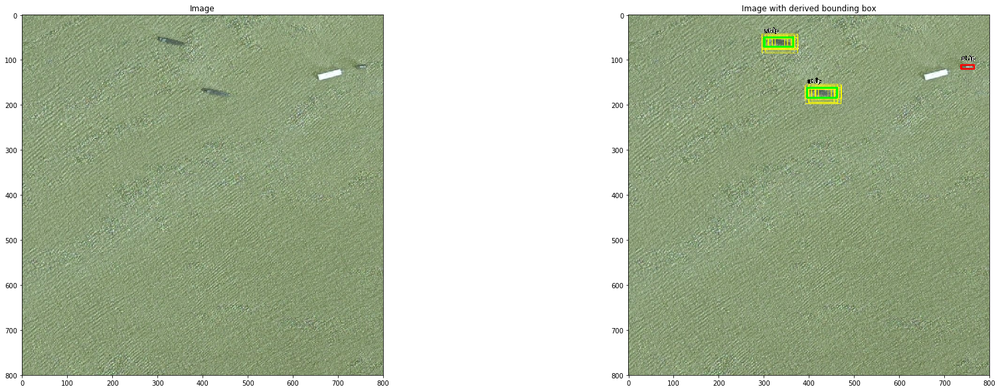

Image ../data/train_v2/c0c617b6d.jpg


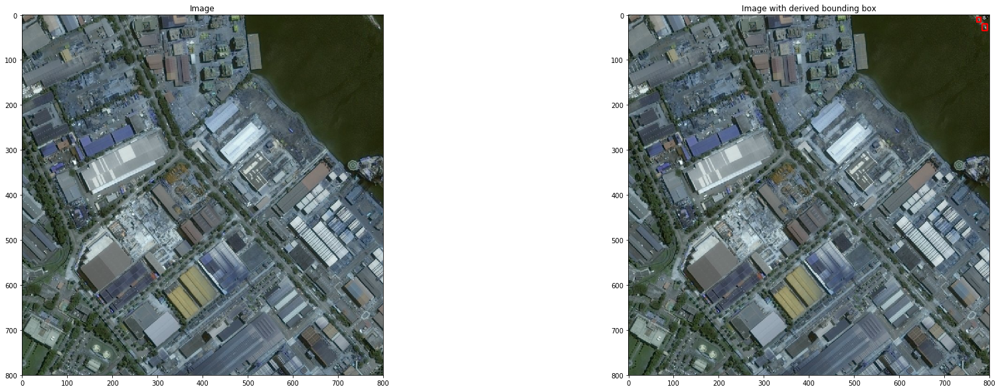

Image ../data/train_v2/c87e98339.jpg


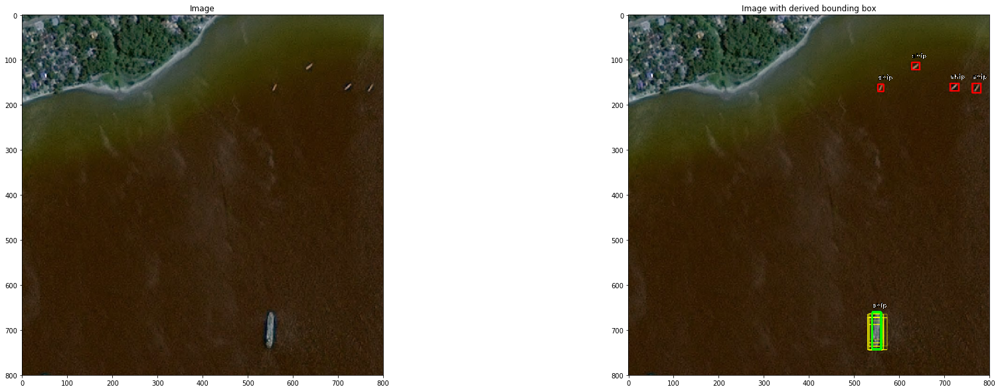

Image ../data/train_v2/3f33be256.jpg


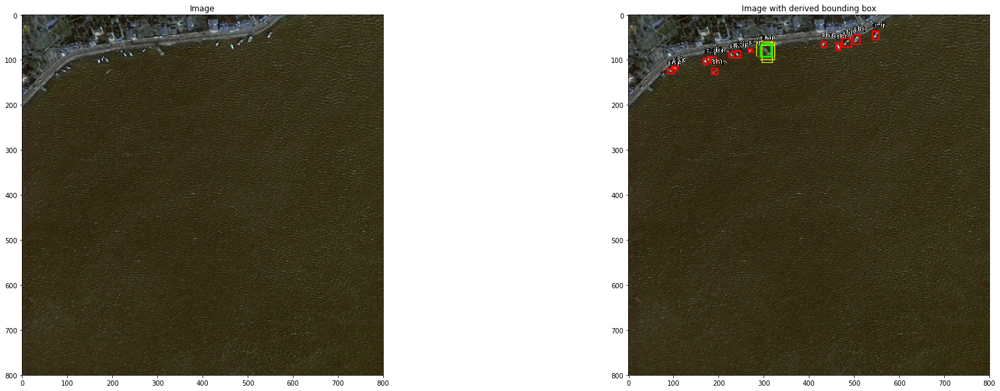

In [1]:
from debug import   parse_args, parse_anchor_parameters, read_config_file, \
                    create_generator, show_images_with_anchors, count_ignored_ships

%matplotlib inline

anchor_params = {
    'sizes':   [32, 64, 128, 256, 512],
    'strides': [8,  16, 32,  64,  128],
    'ratios':  [0.5, 1, 2],
    'scales':  [1, 1.2599210498948732, 1.5874010519681994]
}

pyramid_levels=[3, 4, 5, 6, 7]

show_images_with_anchors(anchor_params, pyramid_levels, '../data/train_v2/train.csv', '../data/bboxes_classes.csv', 10)

Ясно се вижда, че по-малките кораби не могат да бъдат засечени. Нека видим каква част от анотациите ще бъде игнорирана

In [2]:
count_ignored_ships(anchor_params, pyramid_levels, '../data/train_v2/train.csv', '../data/bboxes_classes.csv')

6999  ships ignored out of  13812


Резултатите не са никак добри... половината данни просто ще се изхвърлят, но има и по-голям проблем - всички кораби, които са по-малки от определен размер със сигурност няма да се разпознават от модела

Ще променим scales параметъра и ще добавим търсене на по-малки bounding box-ове. Също така ще добавим и ratio 0.2, за да намираме по-издължените кораби

In [8]:
anchor_params = {
    'sizes':   [16, 32, 64, 128, 256],
    'strides': [4, 8,  16, 32, 64],
    'ratios':  [0.2, 0.5, 1, 2],
    'scales':  [1, 1.2599210498948732, 1.5874010519681994]
}

pyramid_levels=[2, 3, 4, 5, 6]

count_ignored_ships(anchor_params, pyramid_levels, '../data/train_v2/train.csv', '../data/bboxes_classes.csv')

2771  ships ignored out of  13812


Получихме доста по-добри резултати.

След много опити установих, че за съжаление промяната на който и да е от параметрите sizes, strides или pyramid_levels води до получаване на точност 0 върху валидационнот множество. Затова ще променим само ratios и scales.

In [9]:
anchor_params = {
    'sizes':   [32, 64, 128, 256, 512],
    'strides': [8,  16, 32, 64, 128],
    'ratios':  [0.2, 0.5, 1, 2],
    'scales':  [0.5, 1, 1.2599210498948732]
}

pyramid_levels=[3, 4, 5, 6, 7]

count_ignored_ships(anchor_params, pyramid_levels, '../data/train_v2/train.csv', '../data/bboxes_classes.csv')

3477  ships ignored out of  13812


Да видим как изглеждат снимките с новите настройки

Image ../data/train_v2/89c428510.jpg


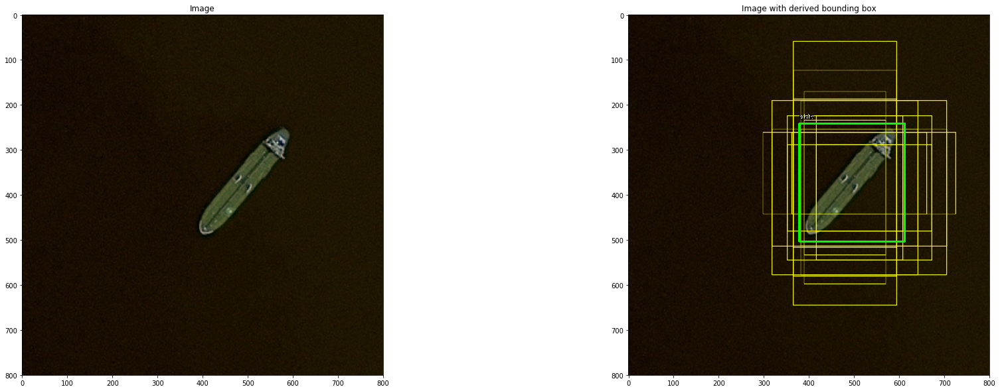

Image ../data/train_v2/aec367d77.jpg


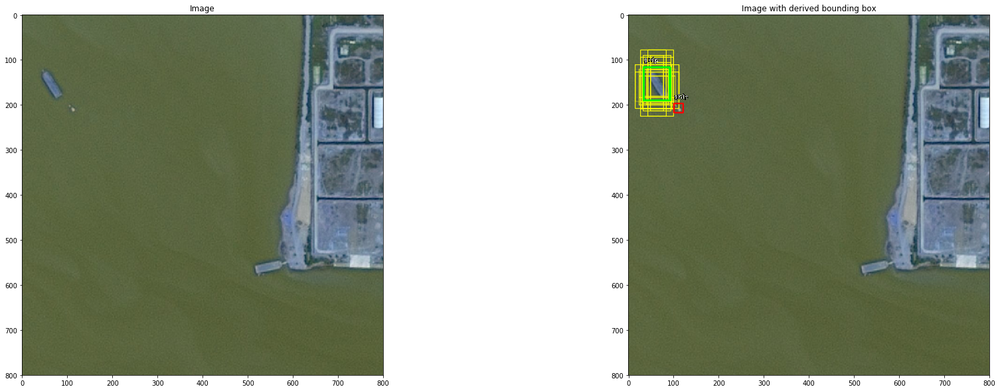

Image ../data/train_v2/9c9d84825.jpg


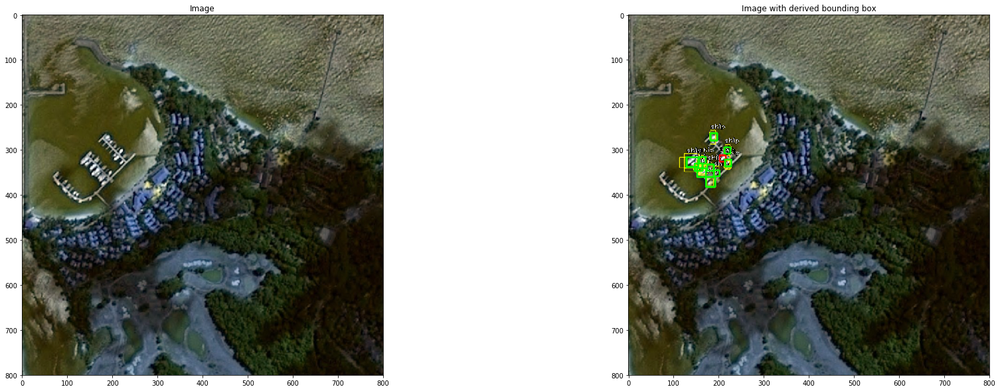

Image ../data/train_v2/07f5077e4.jpg


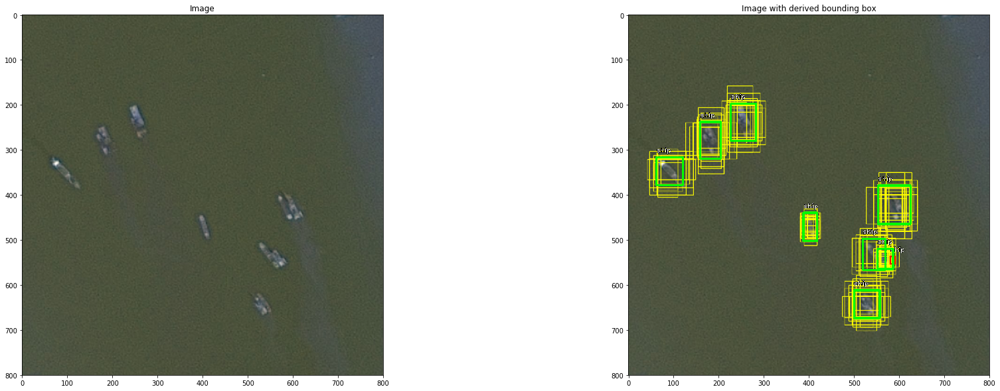

Image ../data/train_v2/4a46b4c0c.jpg


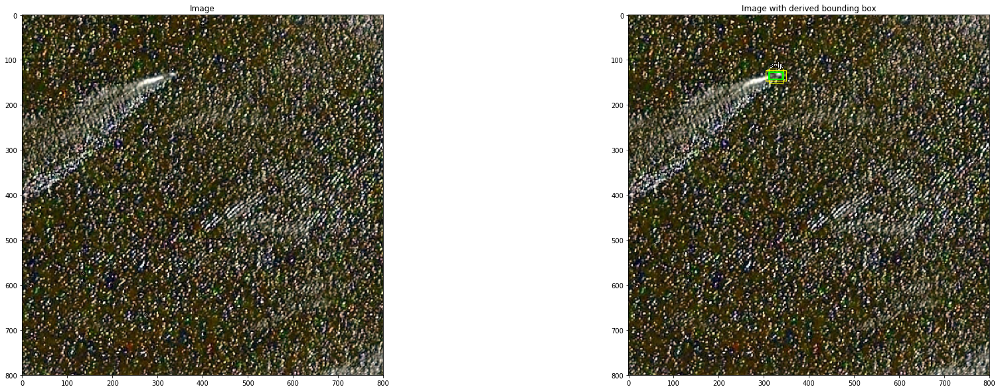

Image ../data/train_v2/559eeffea.jpg


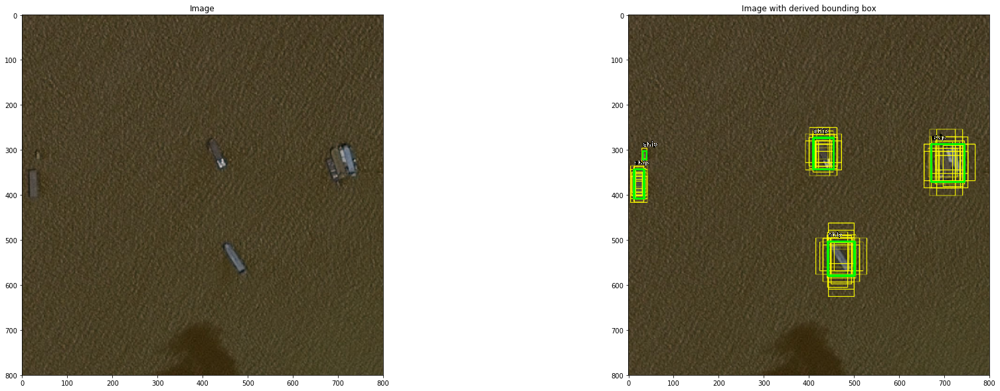

Image ../data/train_v2/c88114242.jpg


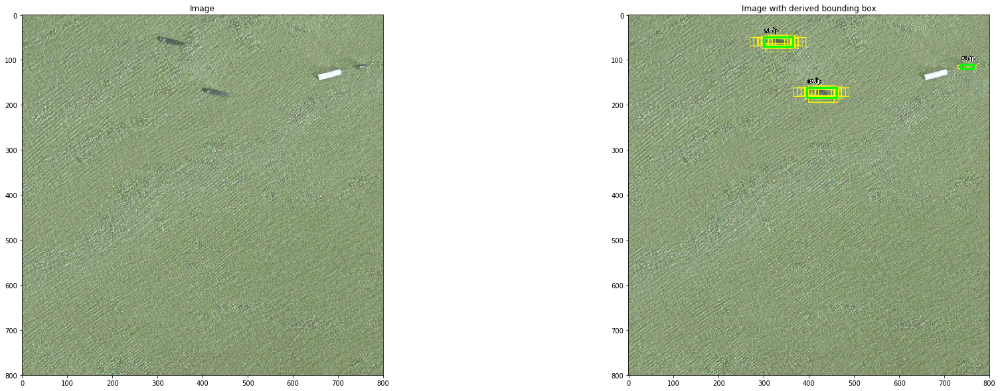

Image ../data/train_v2/c0c617b6d.jpg


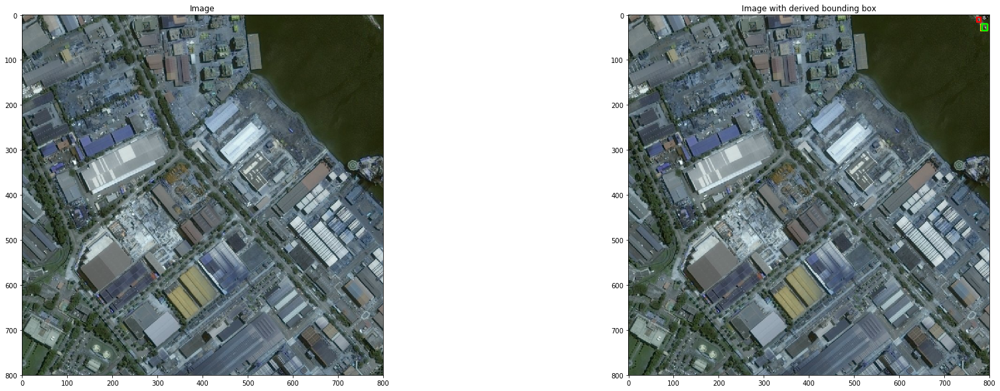

Image ../data/train_v2/c87e98339.jpg


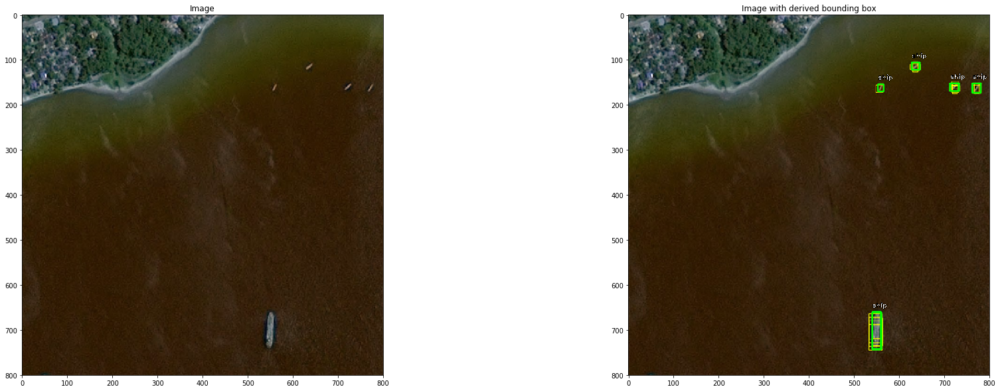

Image ../data/train_v2/3f33be256.jpg


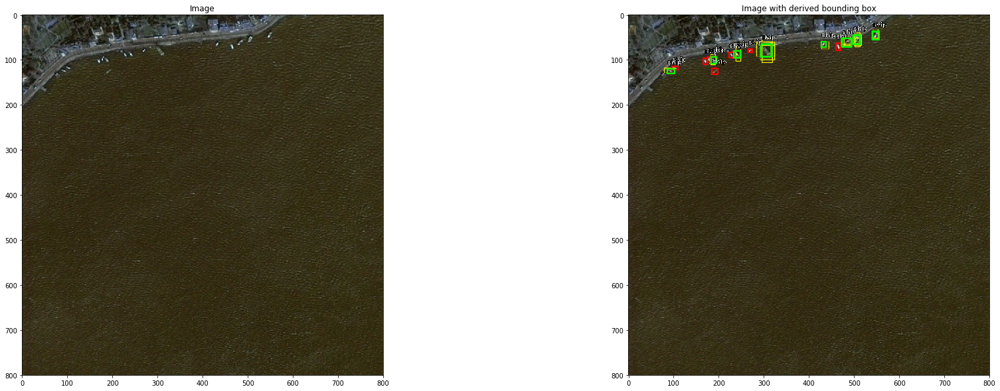

In [12]:
anchor_params = {
    'sizes':   [32, 64, 128, 256, 512],
    'strides': [8,  16, 32, 64, 128],
    'ratios':  [0.2, 0.5, 1, 2],
    'scales':  [0.5, 1, 1.2599210498948732]
}

pyramid_levels=[3, 4, 5, 6, 7]

show_images_with_anchors(anchor_params, pyramid_levels, '../data/train_v2/train.csv', '../data/bboxes_classes.csv', 10)

Все още се игнорират 1/4 от анотациите, но това е най-добрата конфигурация, която имаме за момента. В бъдеще бихме могли да разгледаме по-подробно проблема с нулевата точност, за да можем да тренираме с по-малки bounding box-ове.

# Неуспешни експерименти

Тренираме модела с 22715 тренировъчни и 7587 валидационни примера. Опитах да подам следните anchor параметри (зададени в anchor_parameters.ini файла):

Резултата беше mAP=0 дори след 6 епохи. Бихме могли в бъдеще да проверим защо при промяна на sizes, strides и pyramid_levels, получаваме mAP=0

In [ ]:
import keras

import keras_retinanet.models as models

from train import get_session, create_generators, create_models, create_callbacks, read_config_file

import warnings
warnings.simplefilter("ignore", UserWarning)

config = {
    'backbone': 'resnet50',
    'weights': 'keras-retinanet/snapshots/resnet50_coco_best_v2.1.0.h5',
    'dataset_type': 'csv',
    'annotations': '../data/train_v2/train.csv',
    'classes': '../data/bboxes_classes.csv',
    'val_annotations': '../data/train_v2/validation.csv',
    'multi_gpu': 0,
    'freeze_backbone': False,
    'lr': 1e-5,
    'config': './anchor_parameters.ini',
    
    'steps': None,
    'epochs': 10,
    'workers': 4,
    'max_queue_size': 10,
    'random_transform': False,
    
    'batch_size': 7,
    'image_min_side': 800,
    'image_max_side': 1333,
    'snapshots': True,
    'snapshot_path': './snapshots',
    'evaluation': True,
    'weighted_average': False,
    'tensorboard_dir': './tensorboard_logs'
}

# create object that stores backbone information
backbone = models.backbone(config['backbone'])
keras.backend.tensorflow_backend.set_session(get_session())

if config['config']:
    config['config'] = read_config_file(config['config'])

# create the generators
train_generator, validation_generator = create_generators(config, backbone.preprocess_image)

print('Creating model, this may take a second...')
model, training_model, prediction_model = create_models(
    backbone_retinanet=backbone.retinanet,
    num_classes=train_generator.num_classes(),
    weights=config['weights'],
    multi_gpu=config['multi_gpu'],
    freeze_backbone=config['freeze_backbone'],
    lr=config['lr'],
    config=config['config']
)

# create the callbacks
callbacks = create_callbacks(
    model,
    training_model,
    prediction_model,
    validation_generator,
    config,
)

# start training
training_model.fit_generator(
    generator=train_generator,
    steps_per_epoch=config['steps'],
    epochs=config['epochs'],
    verbose=1,
    callbacks=callbacks,
    workers=config['workers'],
    use_multiprocessing=config['workers'] > 0,
    max_queue_size=config['max_queue_size']
)


Using TensorFlow backend.


Creating model, this may take a second...
Epoch 1/10
1128/1128 [==============================] - 3504s 3s/step - loss: 2.7824 - regression_loss: 1.8235 - classification_loss: 0.9588


Running network: 100% (2632 of 2632) |###| Elapsed Time: 0:09:27 Time:  0:09:27
Parsing annotations: 100% (2632 of 2632) || Elapsed Time: 0:00:00 Time:  0:00:00


7254 instances of class ship with average precision: 0.0000
mAP: 0.0000

Epoch 00001: saving model to ./snapshots/resnet50_csv_01.h5
Epoch 2/10
1128/1128 [==============================] - 3486s 3s/step - loss: 2.8359 - regression_loss: 1.7938 - classification_loss: 1.0421


Running network: 100% (2632 of 2632) |###| Elapsed Time: 0:09:18 Time:  0:09:18
Parsing annotations: 100% (2632 of 2632) || Elapsed Time: 0:00:00 Time:  0:00:00


7254 instances of class ship with average precision: 0.0000
mAP: 0.0000

Epoch 00002: saving model to ./snapshots/resnet50_csv_02.h5
Epoch 3/10
1128/1128 [==============================] - 3484s 3s/step - loss: 2.9055 - regression_loss: 1.8192 - classification_loss: 1.0863


Running network: 100% (2632 of 2632) |###| Elapsed Time: 0:09:20 Time:  0:09:20
Parsing annotations: 100% (2632 of 2632) || Elapsed Time: 0:00:00 Time:  0:00:00


7254 instances of class ship with average precision: 0.0000
mAP: 0.0000

Epoch 00003: saving model to ./snapshots/resnet50_csv_03.h5

Epoch 00003: ReduceLROnPlateau reducing learning rate to 9.999999747378752e-07.
Epoch 4/10
1128/1128 [==============================] - 3487s 3s/step - loss: 2.7823 - regression_loss: 1.8387 - classification_loss: 0.9436


Running network: 100% (2632 of 2632) |###| Elapsed Time: 0:09:19 Time:  0:09:19
Parsing annotations: 100% (2632 of 2632) || Elapsed Time: 0:00:00 Time:  0:00:00


7254 instances of class ship with average precision: 0.0000
mAP: 0.0000

Epoch 00004: saving model to ./snapshots/resnet50_csv_04.h5
Epoch 5/10
1128/1128 [==============================] - 3486s 3s/step - loss: 2.8463 - regression_loss: 1.8436 - classification_loss: 1.0027


Running network: 100% (2632 of 2632) |###| Elapsed Time: 0:09:19 Time:  0:09:19
Parsing annotations: 100% (2632 of 2632) || Elapsed Time: 0:00:00 Time:  0:00:00


7254 instances of class ship with average precision: 0.0000
mAP: 0.0000

Epoch 00005: saving model to ./snapshots/resnet50_csv_05.h5

Epoch 00005: ReduceLROnPlateau reducing learning rate to 9.999999974752428e-08.
Epoch 6/10
1128/1128 [==============================] - 3486s 3s/step - loss: 2.8199 - regression_loss: 1.8128 - classification_loss: 1.0071


Running network: 100% (2632 of 2632) |###| Elapsed Time: 0:09:18 Time:  0:09:18
Parsing annotations: 100% (2632 of 2632) || Elapsed Time: 0:00:00 Time:  0:00:00


7254 instances of class ship with average precision: 0.0000
mAP: 0.0000

Epoch 00006: saving model to ./snapshots/resnet50_csv_06.h5
Epoch 7/10
 999/1128 [=========================>....] - ETA: 6:38 - loss: 2.7575 - regression_loss: 1.7710 - classification_loss: 0.9865

# Успешен експеримент

Тренираме модела с 22715 тренировъчни и 7587 валидационни примера. Пуснах тренирането със следните параметри в anchor_parameters.ini:

Разликите спрямо параметрите по подразбиране са:
- добавих ratio 0.2 с цел да хващат по-дългите кораби
- добавих scale 0.5 и премахнах 1.5874010519681994 с цел да се хващат по-малките кораби

Планът ми беше да го пусна с 20 епохи, но при при 15 вече се виждаше много малко подобрение на епоха (~0.005 mAP) и реших да го спра. Може би с повече данни ще има смисъл и от повече епохи.

In [ ]:
import keras

import keras_retinanet.models as models

from train import get_session, create_generators, create_models, create_callbacks, read_config_file

import warnings
warnings.simplefilter("ignore", UserWarning)


config = {
    'backbone': 'resnet50',
    'weights': 'keras-retinanet/snapshots/resnet50_coco_best_v2.1.0.h5',
    'dataset_type': 'csv',
    'annotations': '../data/train_v2/train.csv',
    'classes': '../data/bboxes_classes.csv',
    'val_annotations': '../data/train_v2/validation.csv',
    'multi_gpu': 0,
    'freeze_backbone': False,
    'lr': 1e-5,
    'config': './anchor_parameters.ini',
    
    'steps': None,
    'epochs': 20,
    'workers': 4,
    'max_queue_size': 10,
    'random_transform': False,
    
    'batch_size': 7,
    'image_min_side': 768,
    'image_max_side': 768,
    'snapshots': True,
    'snapshot_path': './snapshots',
    'evaluation': True,
    'weighted_average': False,
    'tensorboard_dir': './tensorboard_logs'
}

# create object that stores backbone information
backbone = models.backbone(config['backbone'])
keras.backend.tensorflow_backend.set_session(get_session())

if config['config']:
    config['config'] = read_config_file(config['config'])

# create the generators
train_generator, validation_generator = create_generators(config, backbone.preprocess_image)

print('Creating model, this may take a second...')
model, training_model, prediction_model = create_models(
    backbone_retinanet=backbone.retinanet,
    num_classes=train_generator.num_classes(),
    weights=config['weights'],
    multi_gpu=config['multi_gpu'],
    freeze_backbone=config['freeze_backbone'],
    lr=config['lr'],
    config=config['config']
)

print(model.summary())

# create the callbacks
callbacks = create_callbacks(
    model,
    training_model,
    prediction_model,
    validation_generator,
    config,
)

# start training
training_model.fit_generator(
    generator=train_generator,
    steps_per_epoch=config['steps'],
    epochs=config['epochs'],
    verbose=1,
    callbacks=callbacks,
    workers=config['workers'],
    use_multiprocessing=config['workers'] > 0,
    max_queue_size=config['max_queue_size']
)


Using TensorFlow backend.


Creating model, this may take a second...
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, None, None, 3 0                                            
__________________________________________________________________________________________________
padding_conv1 (ZeroPadding2D)   (None, None, None, 3 0           input_1[0][0]                    
__________________________________________________________________________________________________
conv1 (Conv2D)                  (None, None, None, 6 9408        padding_conv1[0][0]              
__________________________________________________________________________________________________
bn_conv1 (BatchNormalization)   (None, None, None, 6 256         conv1[0][0]                      
___________________________________________________________________

Epoch 1/20
1128/1128 [==============================] - 3242s 3s/step - loss: 2.0591 - regression_loss: 1.6351 - classification_loss: 0.4240


Running network: 100% (2632 of 2632) |###| Elapsed Time: 0:08:16 Time:  0:08:16
Parsing annotations: 100% (2632 of 2632) || Elapsed Time: 0:00:00 Time:  0:00:00


7254 instances of class ship with average precision: 0.5214
mAP: 0.5214

Epoch 00001: saving model to ./snapshots/resnet50_csv_01.h5
Epoch 2/20
1128/1128 [==============================] - 3214s 3s/step - loss: 1.1936 - regression_loss: 0.9777 - classification_loss: 0.2159


Running network: 100% (2632 of 2632) |###| Elapsed Time: 0:08:11 Time:  0:08:11
Parsing annotations: 100% (2632 of 2632) || Elapsed Time: 0:00:00 Time:  0:00:00


7254 instances of class ship with average precision: 0.5972
mAP: 0.5972

Epoch 00002: saving model to ./snapshots/resnet50_csv_02.h5
Epoch 3/20
1128/1128 [==============================] - 3223s 3s/step - loss: 0.9853 - regression_loss: 0.8128 - classification_loss: 0.1725


Running network: 100% (2632 of 2632) |###| Elapsed Time: 0:08:14 Time:  0:08:14
Parsing annotations: 100% (2632 of 2632) || Elapsed Time: 0:00:00 Time:  0:00:00


7254 instances of class ship with average precision: 0.6204
mAP: 0.6204

Epoch 00003: saving model to ./snapshots/resnet50_csv_03.h5
Epoch 4/20
1128/1128 [==============================] - 3218s 3s/step - loss: 0.8582 - regression_loss: 0.7114 - classification_loss: 0.1468


Running network: 100% (2632 of 2632) |###| Elapsed Time: 0:08:13 Time:  0:08:13
Parsing annotations: 100% (2632 of 2632) || Elapsed Time: 0:00:00 Time:  0:00:00


7254 instances of class ship with average precision: 0.6502
mAP: 0.6502

Epoch 00004: saving model to ./snapshots/resnet50_csv_04.h5
Epoch 5/20
1128/1128 [==============================] - 3215s 3s/step - loss: 0.7621 - regression_loss: 0.6356 - classification_loss: 0.1265


Running network: 100% (2632 of 2632) |###| Elapsed Time: 0:08:15 Time:  0:08:15
Parsing annotations: 100% (2632 of 2632) || Elapsed Time: 0:00:00 Time:  0:00:00


7254 instances of class ship with average precision: 0.6621
mAP: 0.6621

Epoch 00005: saving model to ./snapshots/resnet50_csv_05.h5
Epoch 6/20
1128/1128 [==============================] - 3215s 3s/step - loss: 0.6853 - regression_loss: 0.5732 - classification_loss: 0.1121


Running network: 100% (2632 of 2632) |###| Elapsed Time: 0:08:13 Time:  0:08:13
Parsing annotations: 100% (2632 of 2632) || Elapsed Time: 0:00:00 Time:  0:00:00


7254 instances of class ship with average precision: 0.6772
mAP: 0.6772

Epoch 00006: saving model to ./snapshots/resnet50_csv_06.h5
Epoch 7/20
1128/1128 [==============================] - 3215s 3s/step - loss: 0.6221 - regression_loss: 0.5237 - classification_loss: 0.0984


Running network: 100% (2632 of 2632) |###| Elapsed Time: 0:08:12 Time:  0:08:12
Parsing annotations: 100% (2632 of 2632) || Elapsed Time: 0:00:00 Time:  0:00:00


7254 instances of class ship with average precision: 0.6882
mAP: 0.6882

Epoch 00007: saving model to ./snapshots/resnet50_csv_07.h5
Epoch 8/20
1128/1128 [==============================] - 3216s 3s/step - loss: 0.5669 - regression_loss: 0.4785 - classification_loss: 0.0884


Running network: 100% (2632 of 2632) |###| Elapsed Time: 0:08:12 Time:  0:08:12
Parsing annotations: 100% (2632 of 2632) || Elapsed Time: 0:00:00 Time:  0:00:00


7254 instances of class ship with average precision: 0.6985
mAP: 0.6985

Epoch 00008: saving model to ./snapshots/resnet50_csv_08.h5
Epoch 9/20
1128/1128 [==============================] - 3215s 3s/step - loss: 0.5173 - regression_loss: 0.4381 - classification_loss: 0.0791


Running network: 100% (2632 of 2632) |###| Elapsed Time: 0:08:12 Time:  0:08:12
Parsing annotations: 100% (2632 of 2632) || Elapsed Time: 0:00:00 Time:  0:00:00


7254 instances of class ship with average precision: 0.7019
mAP: 0.7019

Epoch 00009: saving model to ./snapshots/resnet50_csv_09.h5
Epoch 10/20
1128/1128 [==============================] - 3215s 3s/step - loss: 0.4760 - regression_loss: 0.4049 - classification_loss: 0.0711


Running network: 100% (2632 of 2632) |###| Elapsed Time: 0:08:13 Time:  0:08:13
Parsing annotations: 100% (2632 of 2632) || Elapsed Time: 0:00:00 Time:  0:00:00


7254 instances of class ship with average precision: 0.7128
mAP: 0.7128

Epoch 00010: saving model to ./snapshots/resnet50_csv_10.h5
Epoch 11/20
1128/1128 [==============================] - 3219s 3s/step - loss: 0.4381 - regression_loss: 0.3734 - classification_loss: 0.0647


Running network: 100% (2632 of 2632) |###| Elapsed Time: 0:08:11 Time:  0:08:11
Parsing annotations: 100% (2632 of 2632) || Elapsed Time: 0:00:00 Time:  0:00:00


7254 instances of class ship with average precision: 0.7220
mAP: 0.7220

Epoch 00011: saving model to ./snapshots/resnet50_csv_11.h5
Epoch 12/20
1128/1128 [==============================] - 3216s 3s/step - loss: 0.4072 - regression_loss: 0.3480 - classification_loss: 0.0592


Running network: 100% (2632 of 2632) |###| Elapsed Time: 0:08:13 Time:  0:08:13
Parsing annotations: 100% (2632 of 2632) || Elapsed Time: 0:00:00 Time:  0:00:00


7254 instances of class ship with average precision: 0.7246
mAP: 0.7246

Epoch 00012: saving model to ./snapshots/resnet50_csv_12.h5
Epoch 13/20
1128/1128 [==============================] - 3216s 3s/step - loss: 0.3799 - regression_loss: 0.3261 - classification_loss: 0.0538


Running network: 100% (2632 of 2632) |###| Elapsed Time: 0:08:14 Time:  0:08:14
Parsing annotations: 100% (2632 of 2632) || Elapsed Time: 0:00:00 Time:  0:00:00


7254 instances of class ship with average precision: 0.7265
mAP: 0.7265

Epoch 00013: saving model to ./snapshots/resnet50_csv_13.h5
Epoch 14/20
1128/1128 [==============================] - 3217s 3s/step - loss: 0.3545 - regression_loss: 0.3050 - classification_loss: 0.0494


Running network: 100% (2632 of 2632) |###| Elapsed Time: 0:08:12 Time:  0:08:12
Parsing annotations: 100% (2632 of 2632) || Elapsed Time: 0:00:00 Time:  0:00:00


7254 instances of class ship with average precision: 0.7312
mAP: 0.7312

Epoch 00014: saving model to ./snapshots/resnet50_csv_14.h5
Epoch 15/20
1128/1128 [==============================] - 3216s 3s/step - loss: 0.3314 - regression_loss: 0.2858 - classification_loss: 0.0456


Running network: 100% (2632 of 2632) |###| Elapsed Time: 0:08:13 Time:  0:08:13
Parsing annotations: 100% (2632 of 2632) || Elapsed Time: 0:00:00 Time:  0:00:00


Тренирането отнемаше по около час на епоха. Т.е. за около 15 часа постигнахме mAP ~ 0.73

# Резултати от тренирането

In [1]:
from IPython.core.display import HTML

def show_losses():
    return HTML(' \
        <style> \
          .loss_container { display: flex} \
          .title { font-wieght: bold; font-size: 20px; text-align: center}\
        </style> \
        <div class="loss_container"> \
          <div class="graph"> \
           <div class="title">Focal Loss:</div> \
           <img src="./images/loss.svg" style="width: 700px; height:300px" /> \
          </div> \
          <div class="graph"> \
           <div class="title">Regression Loss:</div> \
           <img src="./images/regression_loss.svg" style="width: 700px; height:300px" /> \
          </div> \
        </div> \
        <div class="loss_container"> \
          <div class="graph"> \
           <div class="title">Classification Loss:</div> \
           <img src="./images/classification_loss.svg" style="width: 700px; height:300px" /> \
          </div> \
          <div class="graph"> \
           <div class="title">mAP:</div> \
           <img src="./images/mAP.svg" style="width: 700px; height:300px" /> \
          </div> \
        </div> \
    ')

Това са резултати от тренирането след 15 епохи. Учудващо е, че mAP е над 70%, тъй като както видяхме по-рано - 1/3 от примерите (най-малките кораби) не се взимат предвид при тренирането

In [2]:
show_losses()

Краен резултат - mAP 0.73 върху тестовото множество.

# Разпознаване на кораби от тренировъчните данни

## Конвертиране на модела от тренировъчен към предсказващ

In [3]:
!retinanet-convert-model --backbone 'resnet50' --config ./anchor_parameters.ini \
                         ./snapshots/resnet50_csv_15.h5 ./snapshots/inference15.h5

Using TensorFlow backend.
2019-02-13 23:16:30.151722: I tensorflow/core/platform/profile_utils/cpu_utils.cc:94] CPU Frequency: 2808000000 Hz
2019-02-13 23:16:30.152295: I tensorflow/compiler/xla/service/service.cc:162] XLA service 0x5635b0934b80 executing computations on platform Host. Devices:
2019-02-13 23:16:30.152330: I tensorflow/compiler/xla/service/service.cc:169]   StreamExecutor device (0): <undefined>, <undefined>
2019-02-13 23:16:30.154739: I tensorflow/stream_executor/platform/default/dso_loader.cc:154] successfully opened CUDA library libcuda.so.1 locally
2019-02-13 23:16:30.159453: E tensorflow/stream_executor/cuda/cuda_driver.cc:303] failed call to cuInit: CUDA_ERROR_NO_DEVICE: no CUDA-capable device is detected
2019-02-13 23:16:30.159493: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:161] retrieving CUDA diagnostic information for host: tisho-ThinkPad-T470p
2019-02-13 23:16:30.159502: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:168] hostname: tisho-Thi

## Зареждаме необходимите модули

In [4]:
import warnings
warnings.simplefilter("ignore", UserWarning)

# disable gpu
import os
os.environ["CUDA_VISIBLE_DEVICES"]="-1"    

# show images inline
%matplotlib inline

# automatically reload modules when they have changed
%load_ext autoreload
%autoreload 2

# import keras
import keras

# import keras_retinanet
from keras_retinanet import models
from keras_retinanet.utils.image import read_image_bgr, preprocess_image, resize_image
from keras_retinanet.utils.visualization import draw_box, draw_caption
from keras_retinanet.utils.colors import label_color

# import miscellaneous modules
import matplotlib.pyplot as plt
import cv2
import os
import numpy as np
import time
import random
import pandas as pd

train_dir = '../data/train_v2'
labels_to_names = {0: 'ship'}

def find_ships(file_names):
    for file in file_names:
        print(file)
        image = read_image_bgr(train_dir + '/' + file)

        # copy to draw on
        draw = image.copy()
        draw = cv2.cvtColor(draw, cv2.COLOR_BGR2RGB)

        # preprocess image for network
        image = preprocess_image(image)
        image, scale = resize_image(image)

        # process image
        start = time.time()
        labels = ['ships']
        boxes, scores, labels = model.predict_on_batch(np.expand_dims(image, axis=0))
        print("processing time: ", time.time() - start)

        # correct for image scale
        boxes /= scale

        # visualize detections
        for box, score, label in zip(boxes[0], scores[0], labels[0]):
            # scores are sorted so we can break
            if score < 0.5:
                break

            color = label_color(label)

            b = box.astype(int)
            draw_box(draw, b, color=color)

            caption = "{} {:.3f}".format(labels_to_names[label], score)
            draw_caption(draw, b, caption)

        plt.figure(figsize=(15, 15))
        plt.axis('off')
        plt.imshow(draw)
        plt.show()

Using TensorFlow backend.


## Зареждаме RetinaNet модела

In [5]:
model_path = os.path.join('snapshots', 'inference15.h5')
model = models.load_model(model_path, backbone_name='resnet50')

## Разпознаване върху тестовите данни

Понякога получаваме по повече от един bounding box за един и същи кораб

7038dc0da.jpg
processing time:  1.5589232444763184


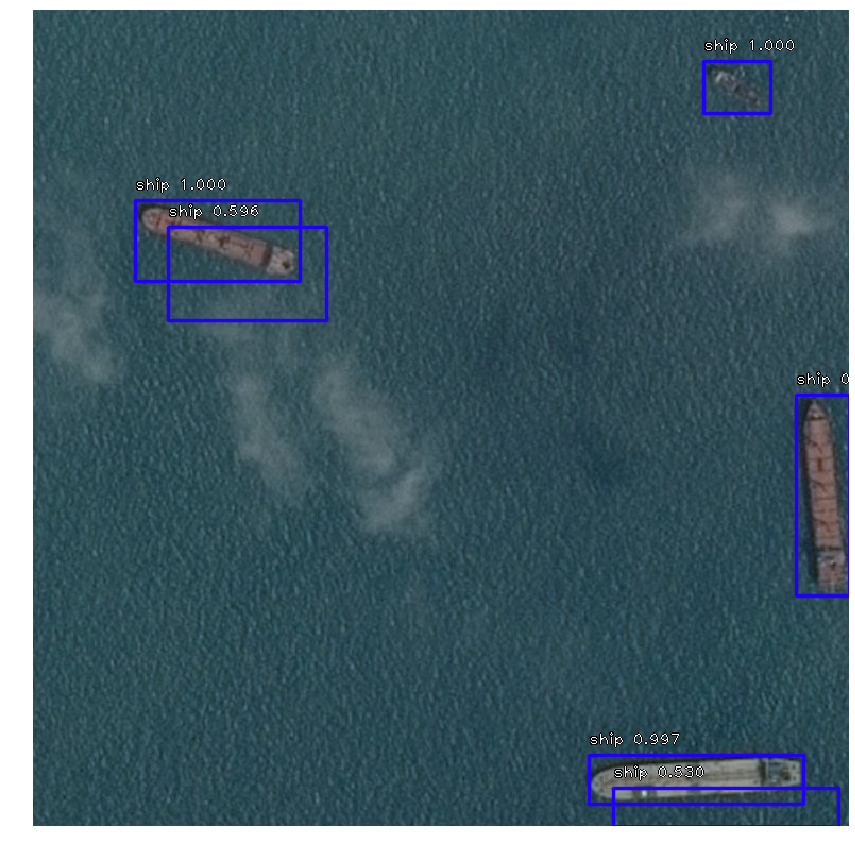

5c7138820.jpg
processing time:  1.036421775817871


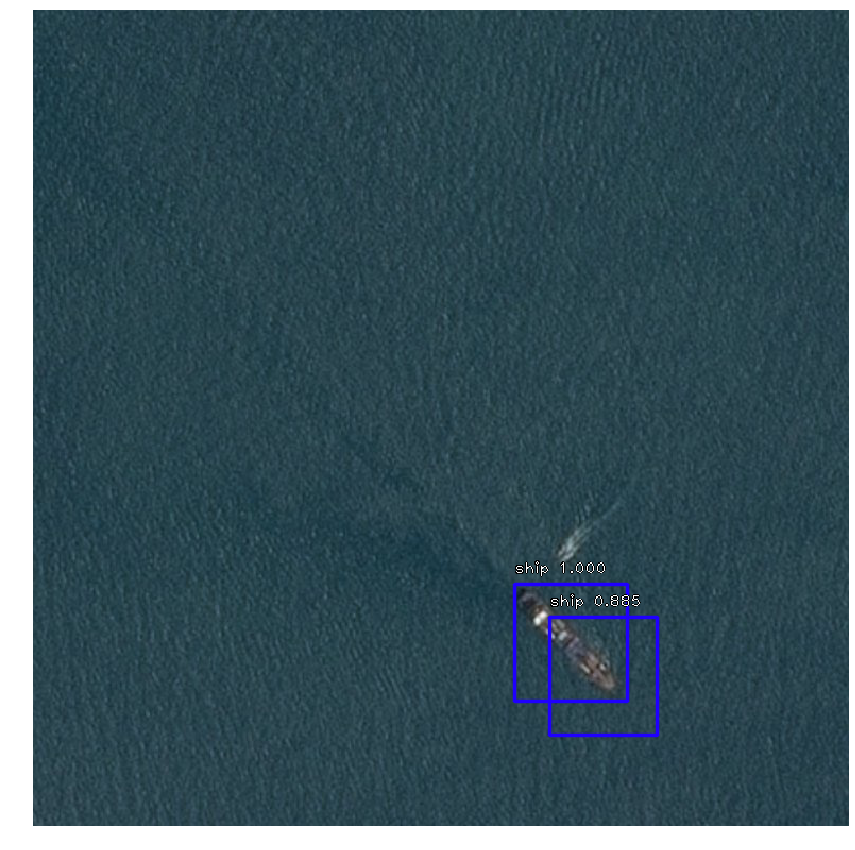

1e7dfe843.jpg
processing time:  1.026292085647583


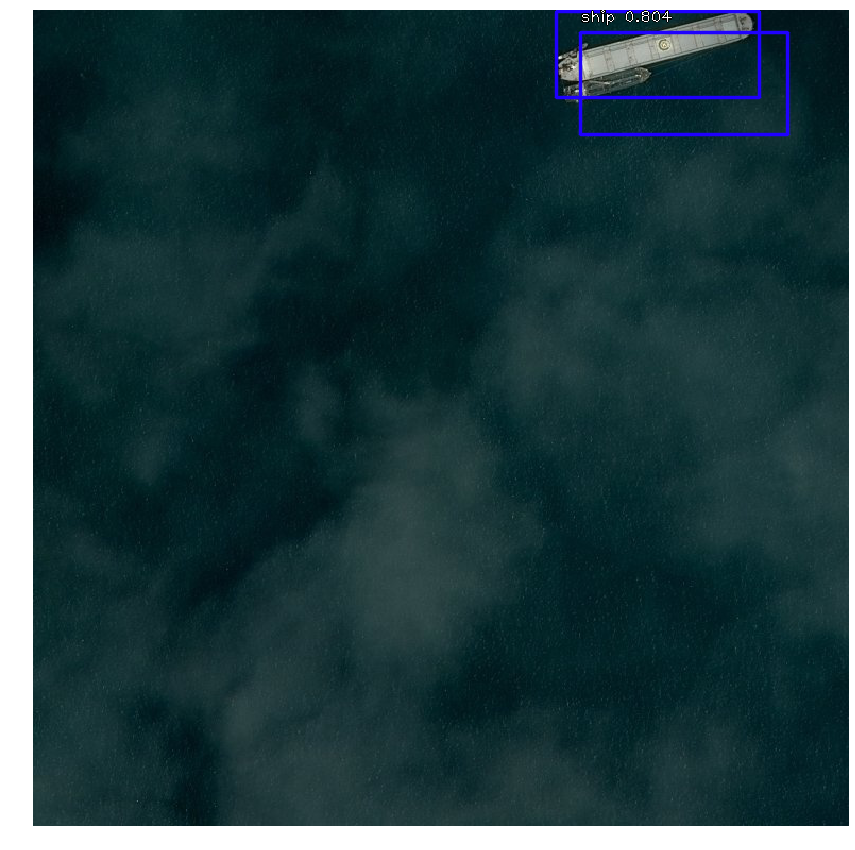

In [6]:
find_ships(['7038dc0da.jpg', '5c7138820.jpg', '1e7dfe843.jpg'])

Понякога, но рядко се разпознават като кораби и други обекти, които са близо до брега

399b9afeb.jpg
processing time:  1.0627961158752441


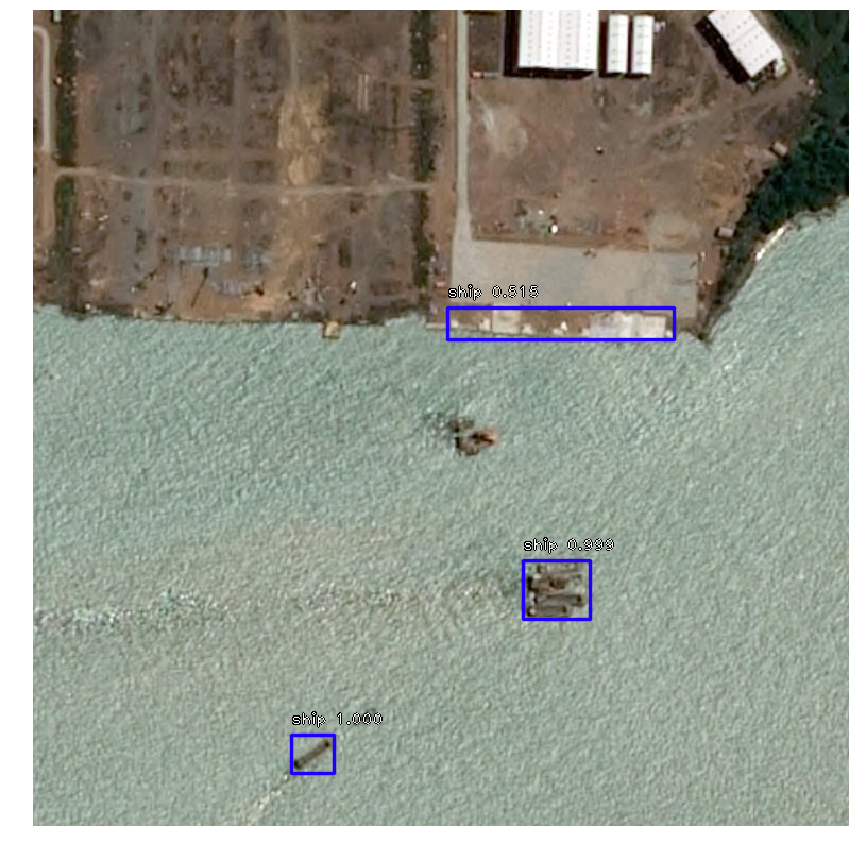

In [7]:
find_ships(['399b9afeb.jpg'])

Както очаквахме - кораби, които са много малки, изобщо не се разпознават

7e19bbc46.jpg
processing time:  1.0160024166107178


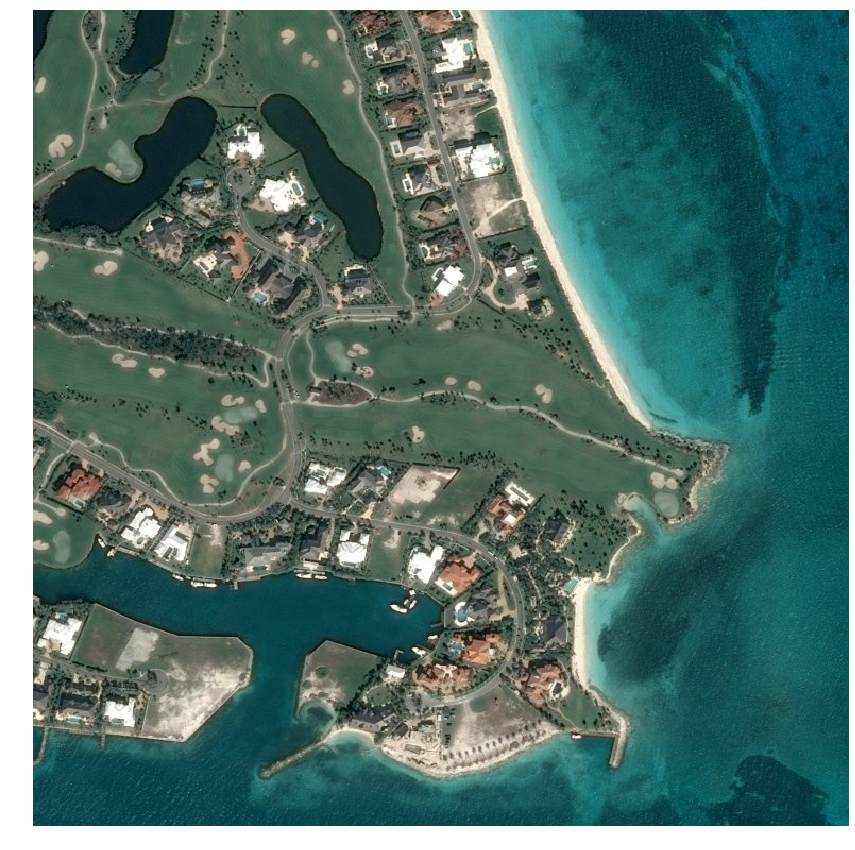

In [8]:
find_ships(['7e19bbc46.jpg'])

Но повечето примери са наистина добри. Разпознават се дори трудно забележими кораби:

08e292c4c.jpg
processing time:  1.0994799137115479


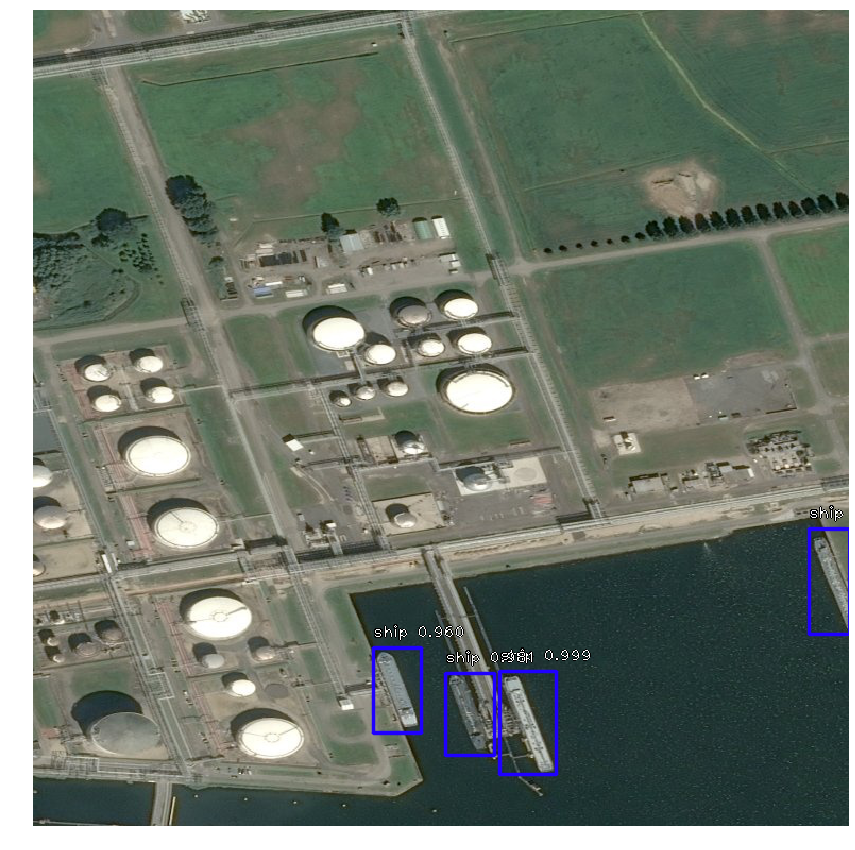

f7e6db7ca.jpg
processing time:  1.0325698852539062


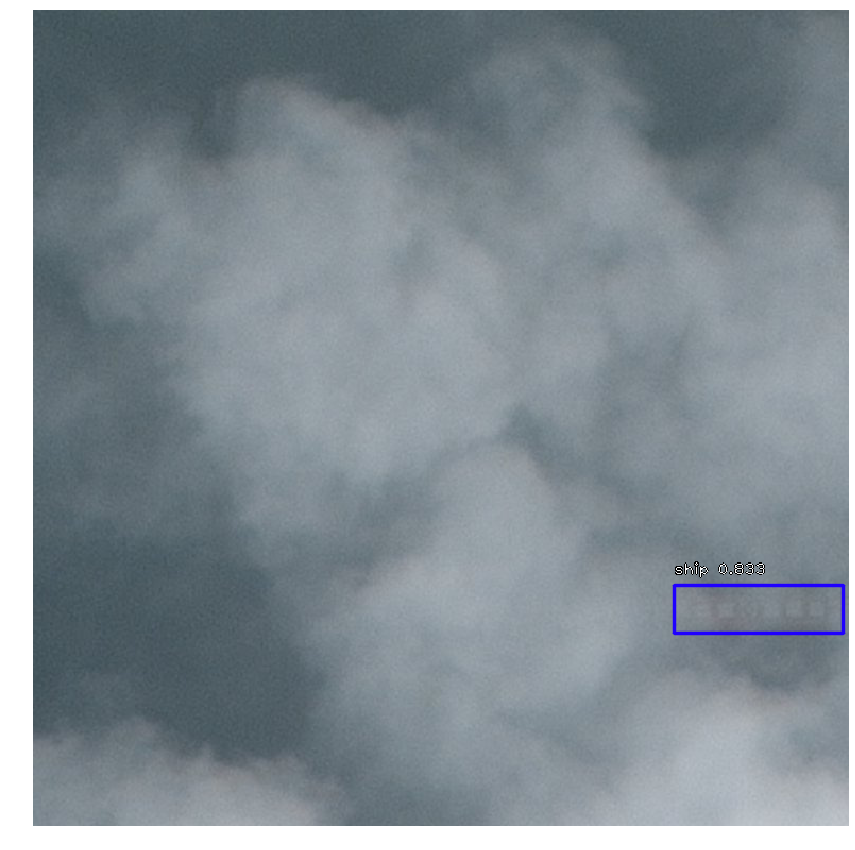

1ccc35901.jpg
processing time:  1.096151351928711


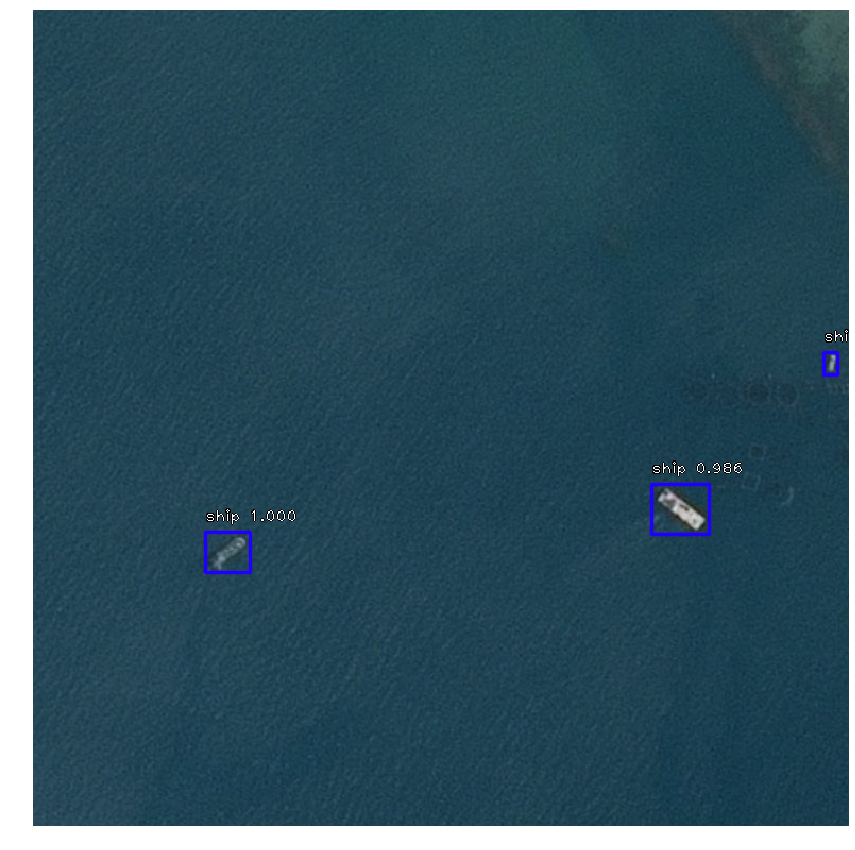

c774ac4fc.jpg
processing time:  1.0173606872558594


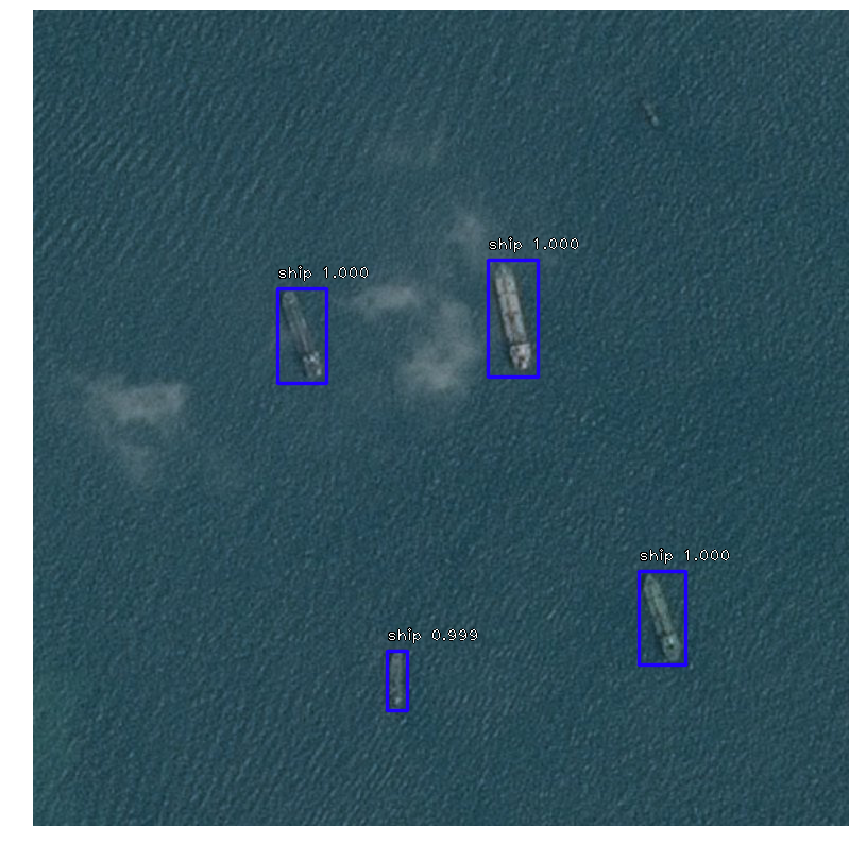

b8f400b68.jpg
processing time:  1.0338654518127441


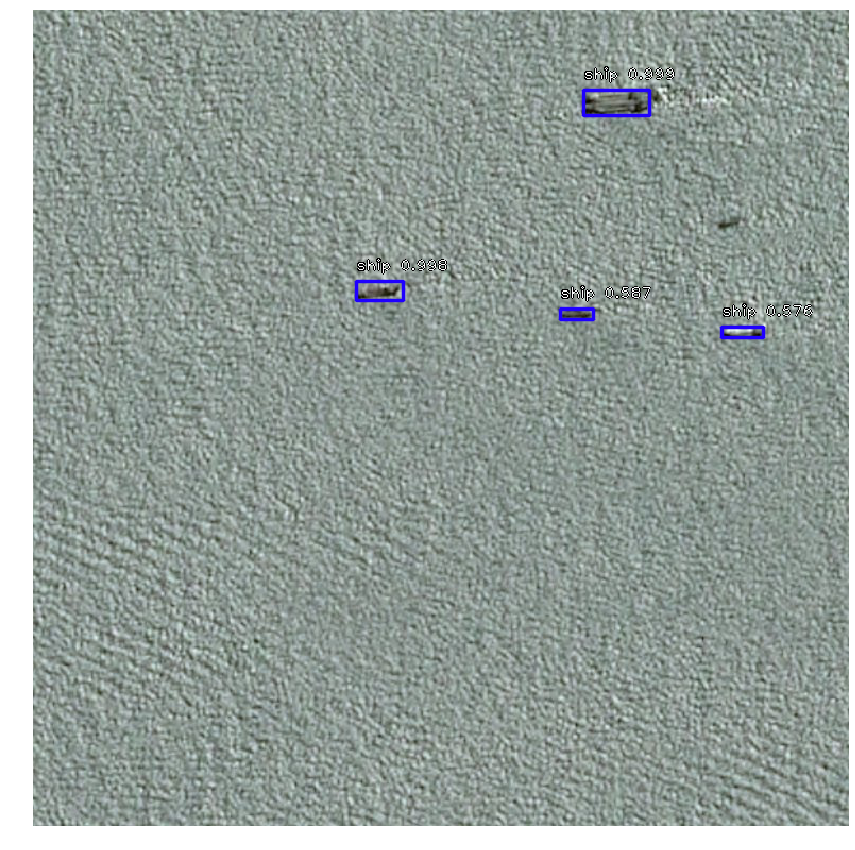

41ed69fc0.jpg
processing time:  1.0387709140777588


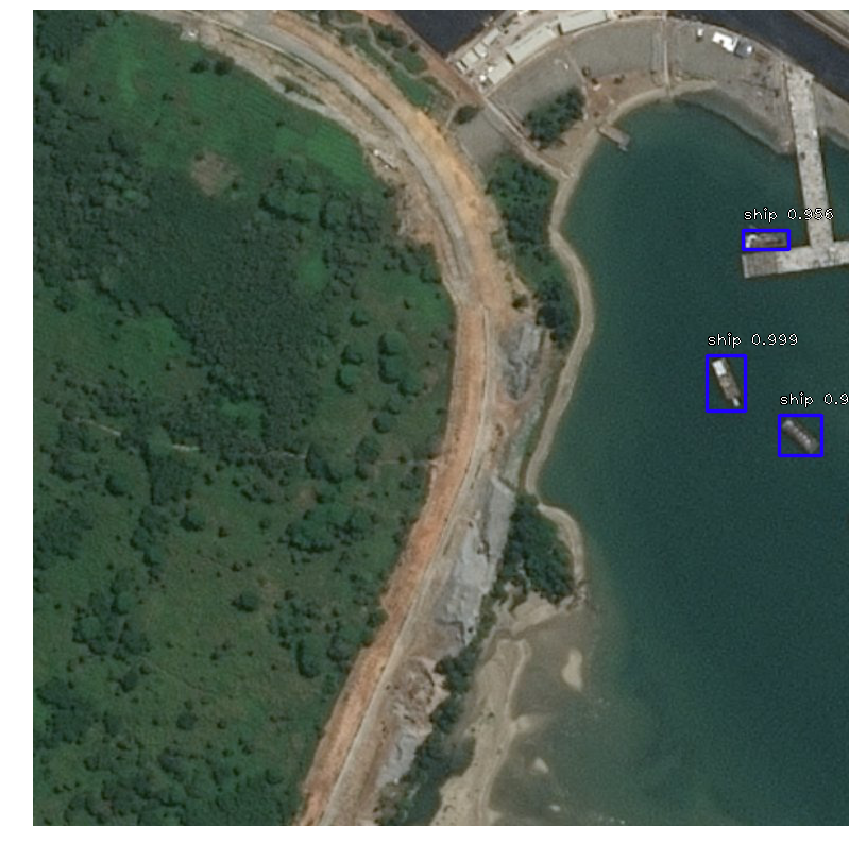

d712631ae.jpg
processing time:  1.0315849781036377


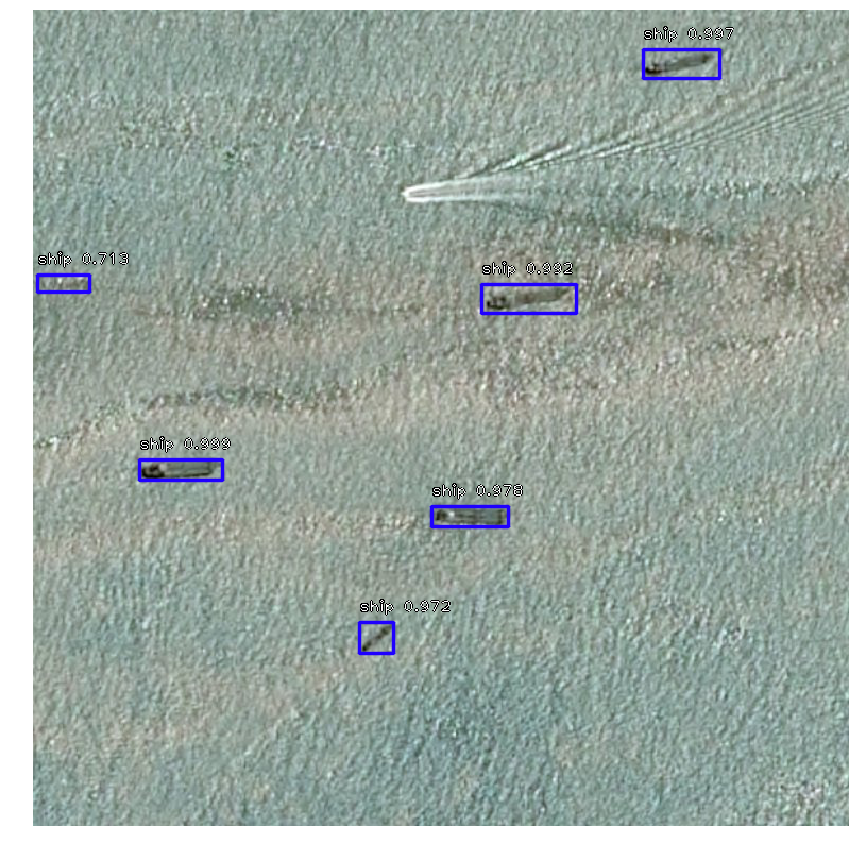

48e2b156c.jpg
processing time:  1.0152597427368164


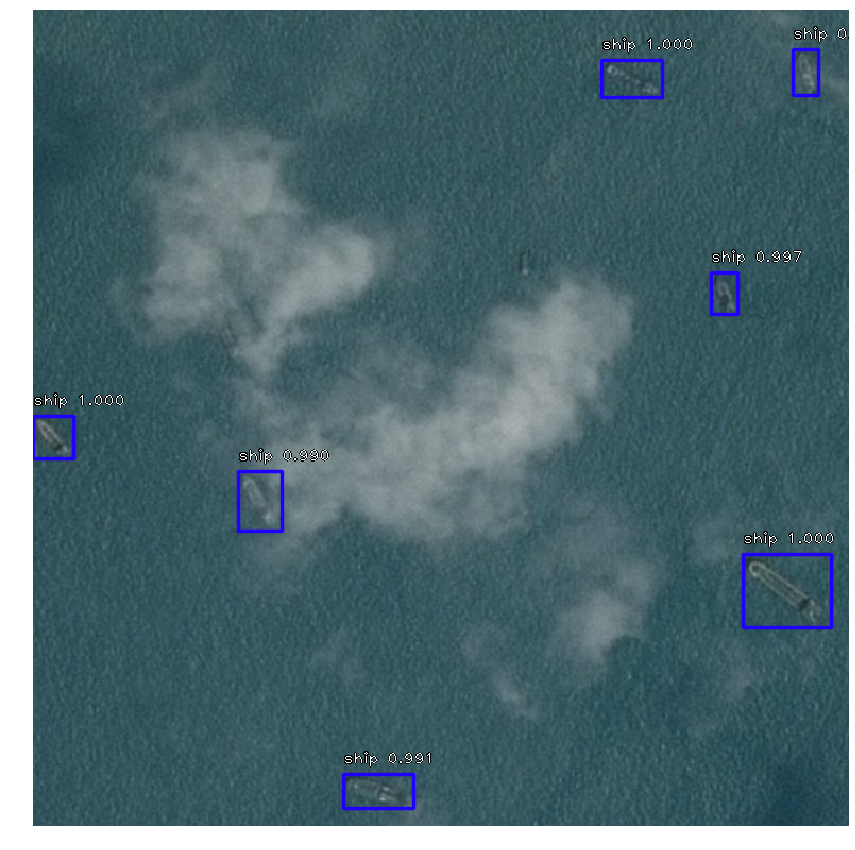

220df0d70.jpg
processing time:  1.014678716659546


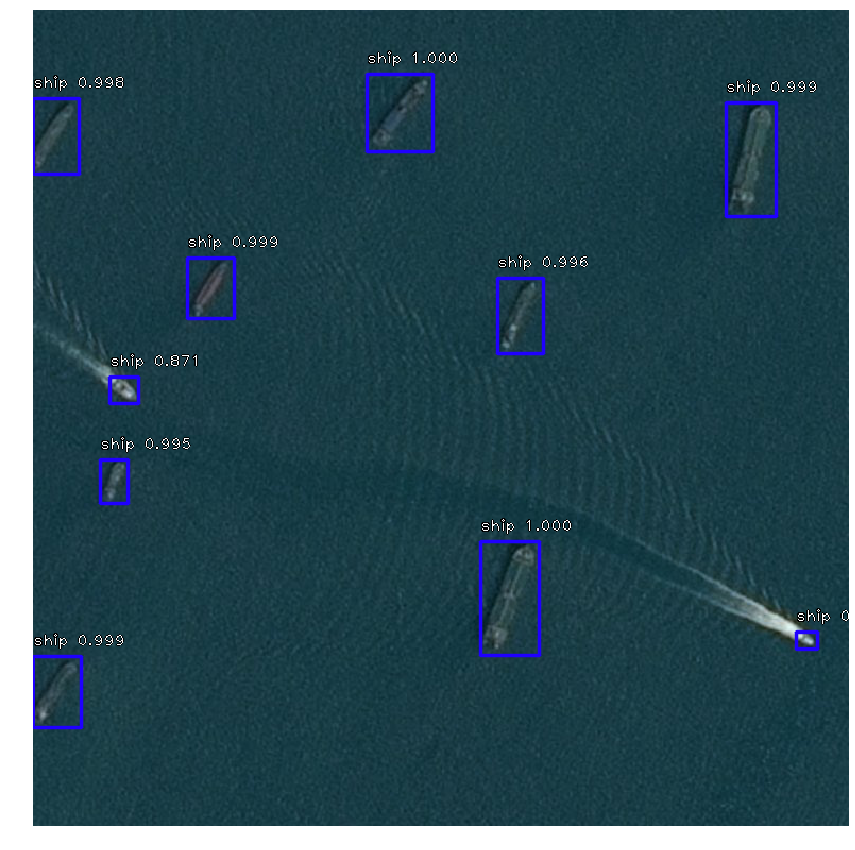

7e483ea08.jpg
processing time:  1.006978988647461


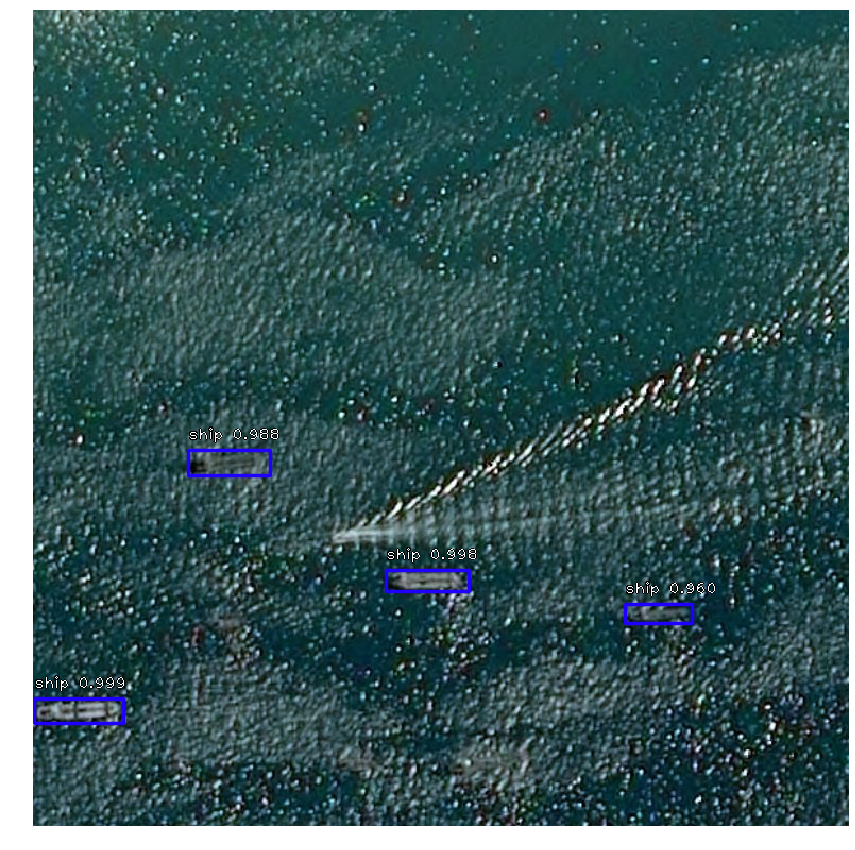

db65f3ecd.jpg
processing time:  1.0351271629333496


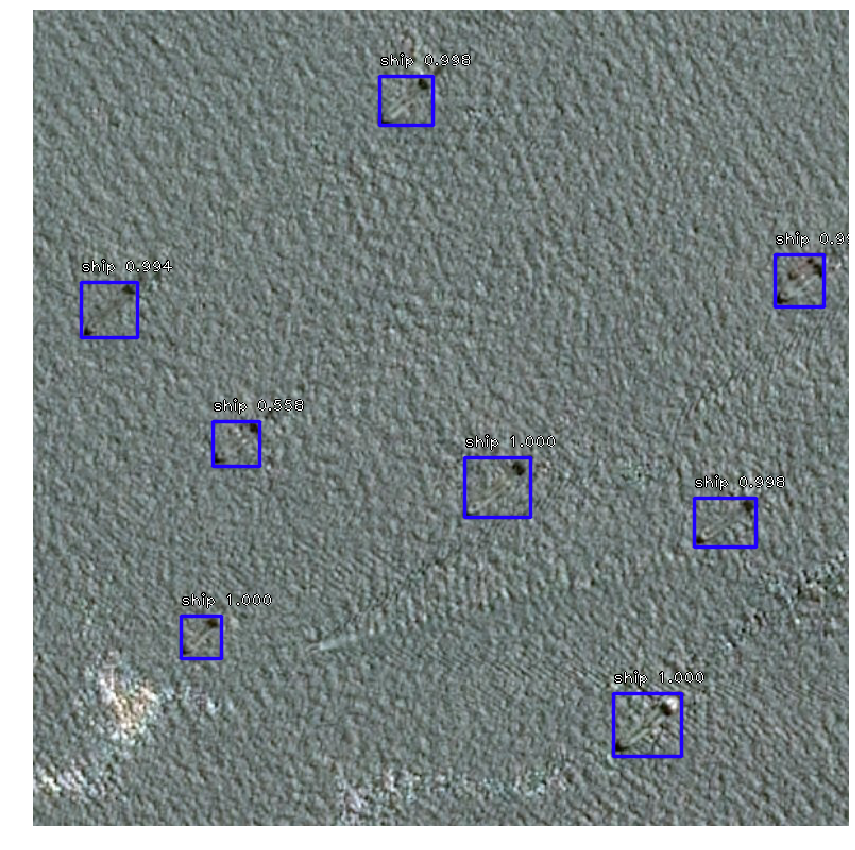

748fde772.jpg
processing time:  1.0280930995941162


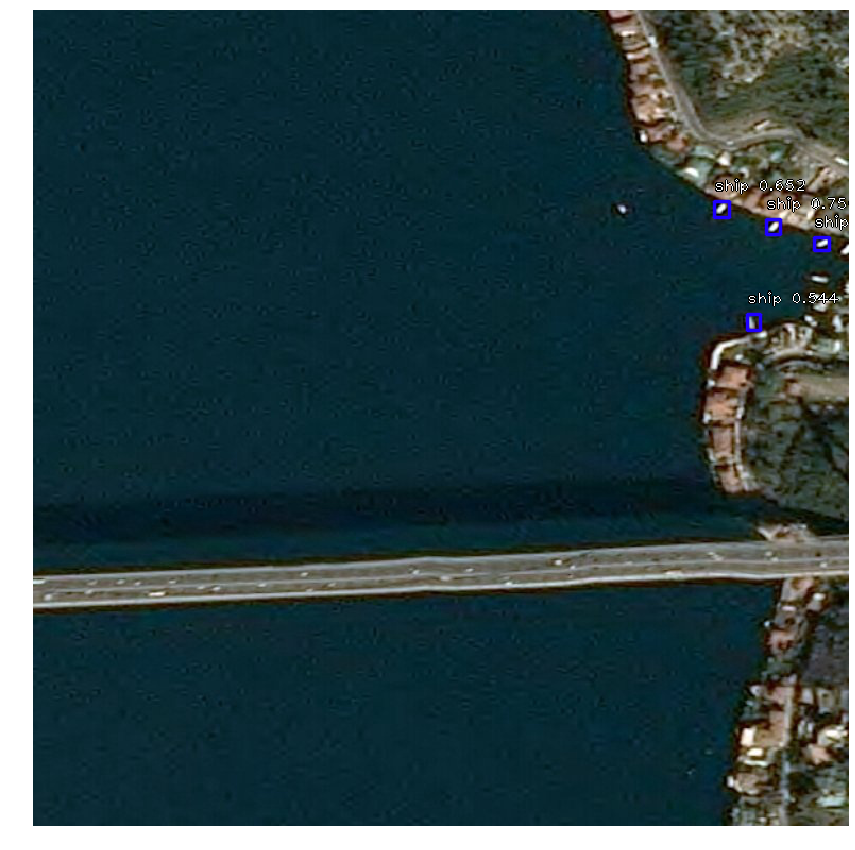

5dc90431e.jpg
processing time:  1.048210859298706


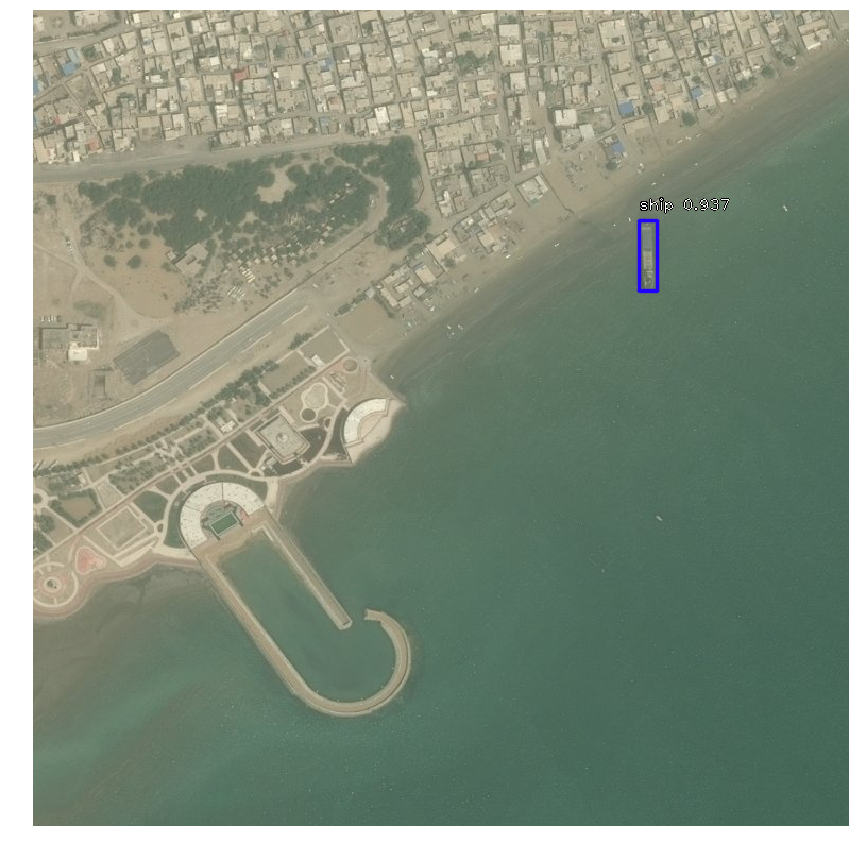

fb5782131.jpg
processing time:  1.0364902019500732


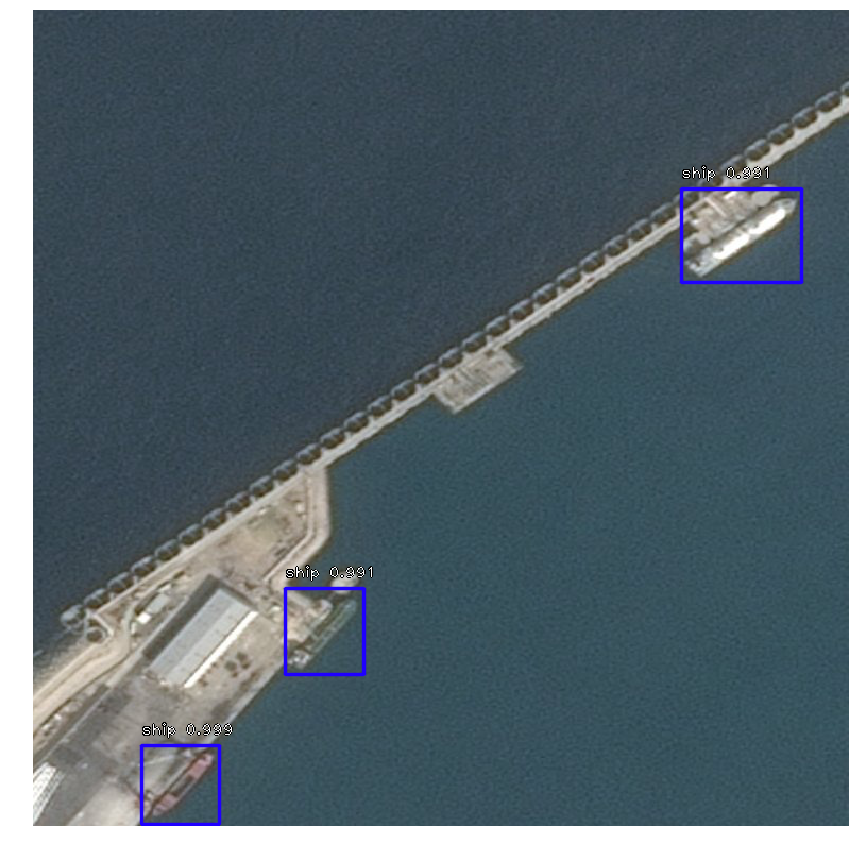

cf9ea31da.jpg
processing time:  1.0386199951171875


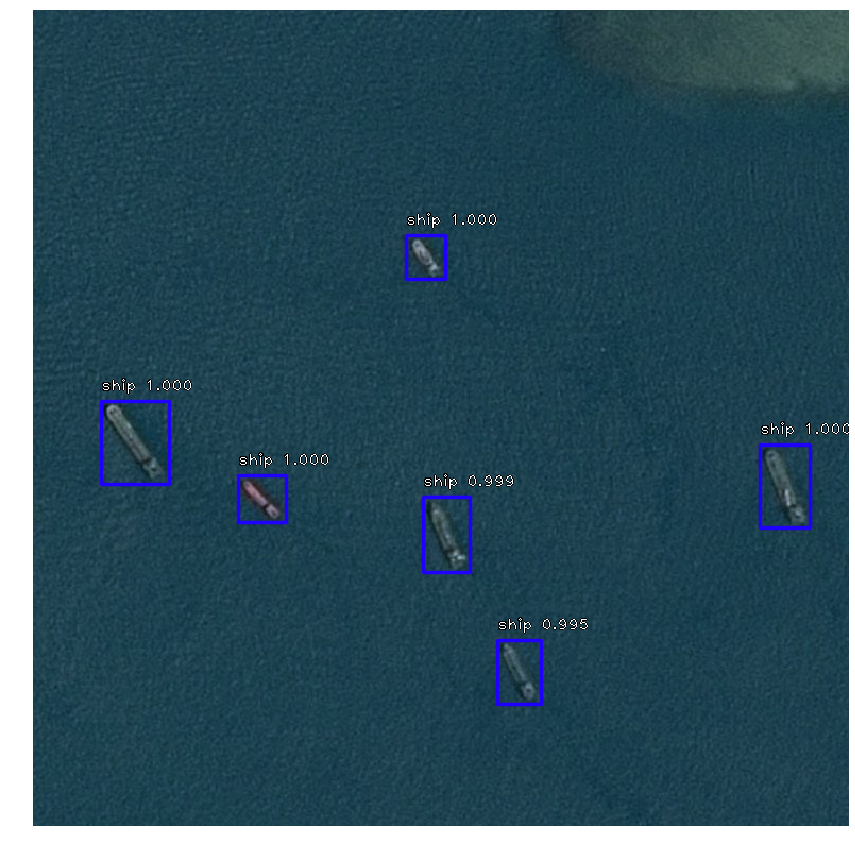

In [9]:
find_ships(['08e292c4c.jpg',
 'f7e6db7ca.jpg',
 '1ccc35901.jpg',
 'c774ac4fc.jpg',
 'b8f400b68.jpg',
 '41ed69fc0.jpg',
 'd712631ae.jpg',
 '48e2b156c.jpg',
 '220df0d70.jpg',
 '7e483ea08.jpg',
 'db65f3ecd.jpg',
 '748fde772.jpg',
 '5dc90431e.jpg',
 'fb5782131.jpg',
 'cf9ea31da.jpg'])

# Изводи

- RetinaNet модела се справя много добре със задачата, дори и с настройки близки до тези по подразбиране.
- Изглежда разпознаването на малки обекти в изображения е труден проблем. Модела се нужда е от допълнителни настройки, за по-добро представяне в тези случаи 

## Идеи за бъдещи подобрения
- Моделът да се тренира върху целия дейтасет
- Да се провери защо при промяна на основните anchor настройки (sizes, strides, pyramid_levels), моделът не работи и постига mAP=0. С тези настройки бихме могли значително да подобрим разпознаването на малките обекти
- Да тренираме модела, използвайки друг backbone, например resnet101 или resnext
- Да тренираме с различни стойности на гама (параметъра за смекчаване на малките грешки)
- Да направим data augmentation - да генерираме нови снимки с променена яркост, контраст, ъгъл